In [1]:
import os
import pydicom
import numpy as np
import matplotlib.pyplot as plt

In [15]:
import nibabel as nib
import numpy as np
import os

# Parameters
case_name = "L067"
nifti_path = f"/mnt/nas7/data/maria/final_features/nifti_new_dataset/{case_name}_volume_hu2.nii"
center = np.array([505, 247, 125])  
radius_mm = 15.2643  # in mm

# Load the NIfTI image
nifti_img = nib.load(nifti_path)
volume = nifti_img.get_fdata()
#volume = np.transpose(volume, (2, 1, 0))  # now shape: (x, y, z)
affine = nifti_img.affine

# Compute voxel size (spacing along each axis)
voxel_spacing = np.sqrt((affine[:3, :3] ** 2).sum(axis=0))  # spacing in mm for x, y, z
print(f"Voxel spacing: {voxel_spacing}")

print(f"Center in voxels: {center}")

# Convert radius from mm to voxels
radius_voxels = (radius_mm / voxel_spacing).astype(int)
radius_voxels = radius_voxels*6
print(f"Radius in voxels: {radius_voxels}")

# Define the bounds of the patch
min_corner = np.maximum(center - radius_voxels, 0)
max_corner = np.minimum(center + radius_voxels + 1, volume.shape)

# Extract the patch
patch = volume[min_corner[0]:max_corner[0],
               min_corner[1]:max_corner[1],
               min_corner[2]:max_corner[2]]

patch = volume[min_corner[0]:max_corner[0],
               min_corner[2]:max_corner[2],
               min_corner[1]:max_corner[1]]
print(f"Extracted patch shape: {patch.shape}")

# Save the extracted patch as a new NIfTI file
patch_nifti = nib.Nifti1Image(patch, affine)  # Use the original affine for consistency
patch_output_path = f"/mnt/nas7/data/maria/final_features/patches/{case_name}_patch3.nii"

# Make sure the output directory exists
os.makedirs(os.path.dirname(patch_output_path), exist_ok=True)

# Save the NIfTI file
nib.save(patch_nifti, patch_output_path)
print(f"Patch saved to {patch_output_path}")


Voxel spacing: [0.6640625  0.6640625  0.80000001]
Center in voxels: [505 247 125]
Radius in voxels: [132 132 114]
Extracted patch shape: (187, 229, 265)
Patch saved to /mnt/nas7/data/maria/final_features/patches/L067_patch3.nii


In [30]:
print(volume.shape)

(512, 512, 560)


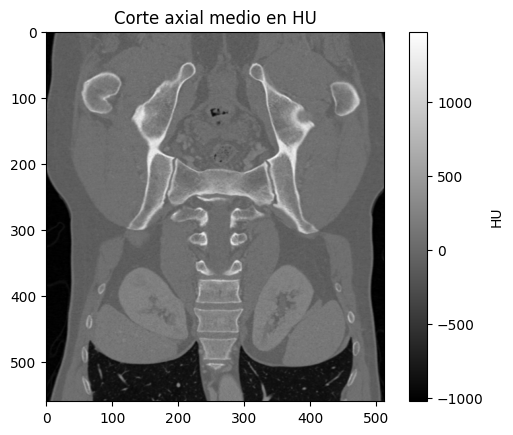

In [8]:
# Visualizar un corte medio
#plt.imshow(volume[505,:,:], cmap='gray')
plt.imshow(volume[:,280,:], cmap='gray')

plt.title("Corte axial medio en HU")
plt.colorbar(label="HU")
plt.show()

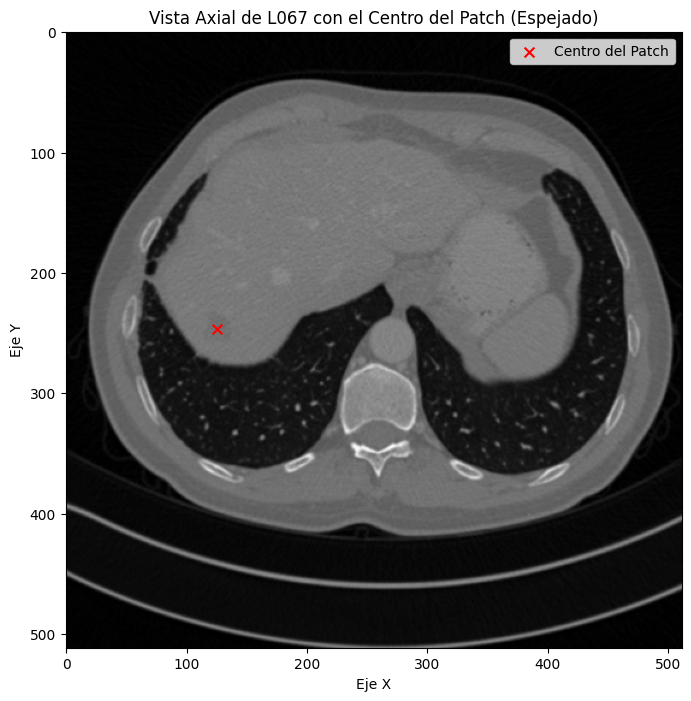

In [60]:
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt

# Parámetros
case_name = "L067"
nifti_path = f"/mnt/nas7/data/maria/final_features/nifti_new_dataset/{case_name}_volume_hu.nii"
#center = np.array([125, 247, 135])  
center = np.array([505, 247, 125])  

# Cargar la imagen NIfTI
nifti_img = nib.load(nifti_path)
volume = nifti_img.get_fdata()
affine = nifti_img.affine

# Extraer la vista axial (corte en el plano Z)
# Seleccionamos una imagen en el eje Z que esté cerca del centro
axial_slice = volume[505, :, :]

# Crear una figura para mostrar la imagen
plt.figure(figsize=(8, 8))
plt.imshow(axial_slice, cmap="gray")

# Marcar el centro del patch en la imagen (ajustado a las dimensiones del giro)
plt.scatter(center[2], center[1], color='red', s=50, marker='x', label='Centro del Patch')

# Añadir etiquetas y título
plt.title(f"Vista Axial de {case_name} con el Centro del Patch (Espejado)")
plt.xlabel("Eje X")
plt.ylabel("Eje Y")
plt.legend()

# Mostrar la imagen
plt.show()



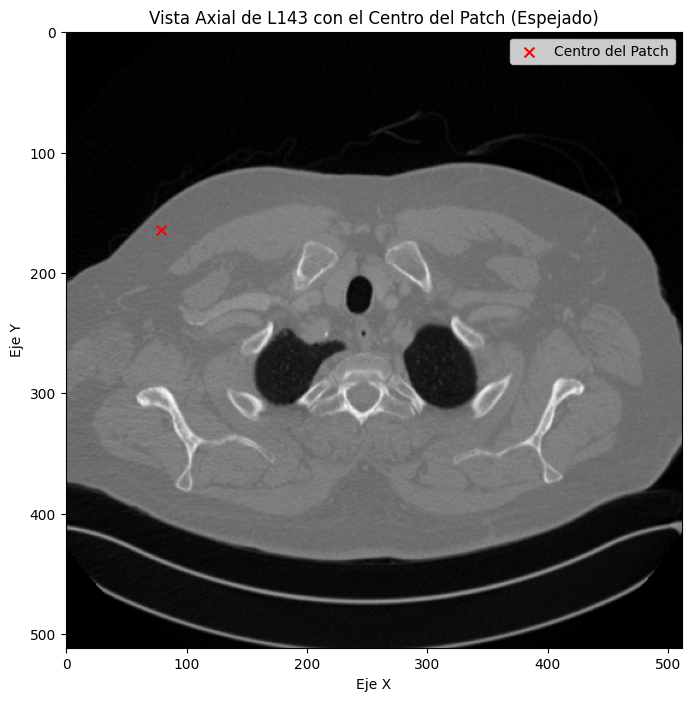

Voxel spacing: [0.8203125  0.8203125  0.80000001]
Center in voxels: [ 79 164  79]
Radius in voxels: [19 19 20]
Extracted patch shape: (39, 39, 41)
Patch saved to /mnt/nas7/data/maria/final_features/patches_lowdose/L143_patch.nii


In [ ]:
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt

# Parámetros
case_name = "L143"
nifti_path = f"/mnt/nas7/data/maria/final_features/nifti_new_dataset/FD_{case_name}.nii"
#center = np.array([125, 247, 135])  
#center = np.array([505, 247, 125])  

center = np.array([79, 164, 79]) 

# Cargar la imagen NIfTI
nifti_img = nib.load(nifti_path)
volume = nifti_img.get_fdata()
affine = nifti_img.affine

# Extraer la vista axial (corte en el plano Z)
# Seleccionamos una imagen en el eje Z que esté cerca del centro
#axial_slice = volume[505, :, :]
axial_slice = volume[539, :, :]

# Crear una figura para mostrar la imagen
plt.figure(figsize=(8, 8))
plt.imshow(axial_slice, cmap="gray")

# Marcar el centro del patch en la imagen (ajustado a las dimensiones del giro)
plt.scatter(center[2], center[1], color='red', s=50, marker='x', label='Centro del Patch')

# Añadir etiquetas y título
plt.title(f"Vista Axial de {case_name} con el Centro del Patch (Espejado)")
plt.xlabel("Eje X")
plt.ylabel("Eje Y")
plt.legend()

# Mostrar la imagen
plt.show()


#radius_mm = 15.2643  # in mm
radius_mm = 16.1555

# Compute voxel size (spacing along each axis)
voxel_spacing = np.sqrt((affine[:3, :3] ** 2).sum(axis=0))  # spacing in mm for x, y, z
print(f"Voxel spacing: {voxel_spacing}")
print(f"Center in voxels: {center}")

# Convert radius from mm to voxels
radius_voxels = (radius_mm / voxel_spacing).astype(int)
print(f"Radius in voxels: {radius_voxels}")

# Define the bounds of the patch
min_corner = np.maximum(center - radius_voxels, 0)
max_corner = np.minimum(center + radius_voxels + 1, volume.shape)

# Extract the patch
patch = volume[min_corner[0]:max_corner[0],
               min_corner[1]:max_corner[1],
               min_corner[2]:max_corner[2]]

print(f"Extracted patch shape: {patch.shape}")

# Save the extracted patch as a new NIfTI file
patch_nifti = nib.Nifti1Image(patch, affine)  # Use the original affine for consistency
patch_output_path = f"/mnt/nas7/data/maria/final_features/patches_lowdose/FD_{case_name}_patch.nii"

# Make sure the output directory exists
os.makedirs(os.path.dirname(patch_output_path), exist_ok=True)

# Save the NIfTI file
nib.save(patch_nifti, patch_output_path)
print(f"Patch saved to {patch_output_path}")

In [27]:
print("Original volume HU range:", volume.min(), volume.max())
print("Patch HU range:", patch.min(), patch.max())


Original volume HU range: -1024.0 2340.0
Patch HU range: -961.0 307.0


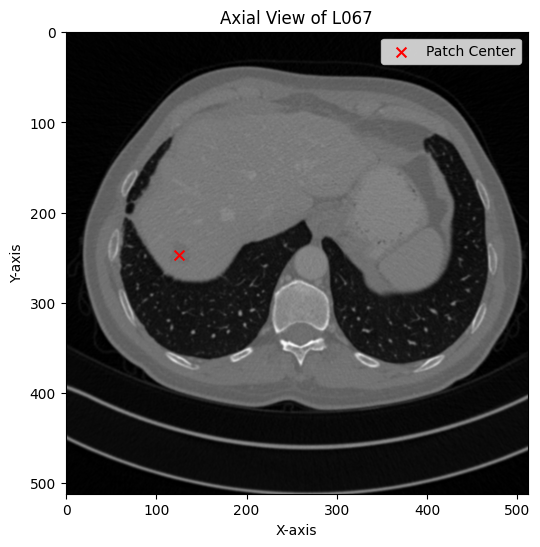

Patch shape before resampling: (45, 45, 39)
Voxel spacing: [0.6640625  0.6640625  0.80000001]
Patch shape after resampling: (30, 30, 31)


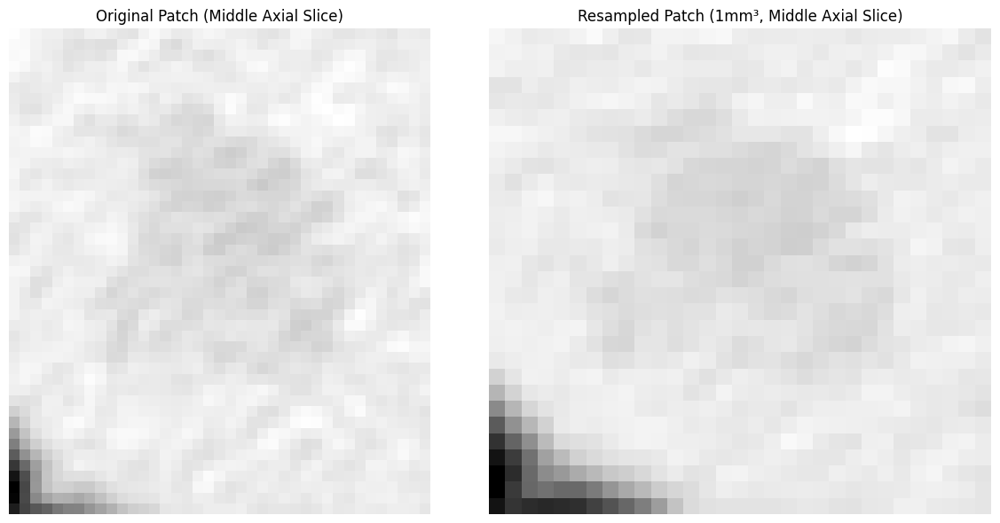

Resampled patch saved to /mnt/nas7/data/maria/final_features/patches/L067_patch_1mm.nii


In [2]:
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt
import os
from scipy.ndimage import zoom

# Parameters
case_name = "L067"
nifti_path = f"/mnt/nas7/data/maria/final_features/nifti_new_dataset/FD_{case_name}.nii"
center = np.array([505, 247, 125])  # center in voxel coordinates

# Load the NIfTI image
nifti_img = nib.load(nifti_path)
volume = nifti_img.get_fdata()
affine = nifti_img.affine

# Visualize a slice from the original volume
axial_slice = volume[center[0], :, :]
plt.figure(figsize=(6, 6))
plt.imshow(axial_slice, cmap="gray")
plt.scatter(center[2], center[1], color='red', s=50, marker='x', label='Patch Center')
plt.title(f"Axial View of {case_name}")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")
plt.legend()
plt.show()

# Patch extraction
radius_mm = 15.2643  # in mm
voxel_spacing = np.sqrt((affine[:3, :3] ** 2).sum(axis=0))  # spacing in mm for x, y, z
radius_voxels = (radius_mm / voxel_spacing).astype(int)

min_corner = np.maximum(center - radius_voxels, 0)
max_corner = np.minimum(center + radius_voxels + 1, volume.shape)
patch = volume[min_corner[0]:max_corner[0],
               min_corner[1]:max_corner[1],
               min_corner[2]:max_corner[2]]

print(f"Patch shape before resampling: {patch.shape}")
print(f"Voxel spacing: {voxel_spacing}")

# Resampling to 1x1x1 mm
zoom_factors = voxel_spacing / 1.0  # target spacing is 1mm
patch_resampled = zoom(patch, zoom=zoom_factors, order=1)
print(f"Patch shape after resampling: {patch_resampled.shape}")

# Plot side-by-side comparison (middle axial slice)
mid_slice_orig = patch.shape[0] // 2
mid_slice_resampled = patch_resampled.shape[0] // 2

fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(patch[mid_slice_orig, :, :], cmap="gray")
axes[0].set_title("Original Patch (Middle Axial Slice)")
axes[0].axis('off')

axes[1].imshow(patch_resampled[mid_slice_resampled, :, :], cmap="gray")
axes[1].set_title("Resampled Patch (1mm³, Middle Axial Slice)")
axes[1].axis('off')

plt.tight_layout()
plt.show()

# Save resampled patch as NIfTI
new_affine = np.diag([1, 1, 1, 1])  # identity affine with 1mm spacing
patch_output_path = f"/mnt/nas7/data/maria/final_features/patches/{case_name}_patch_1mm.nii"
os.makedirs(os.path.dirname(patch_output_path), exist_ok=True)
patch_nifti = nib.Nifti1Image(patch_resampled, new_affine)
nib.save(patch_nifti, patch_output_path)
print(f"Resampled patch saved to {patch_output_path}")


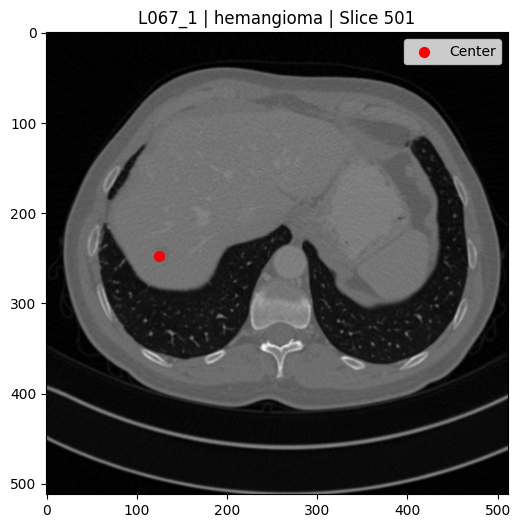

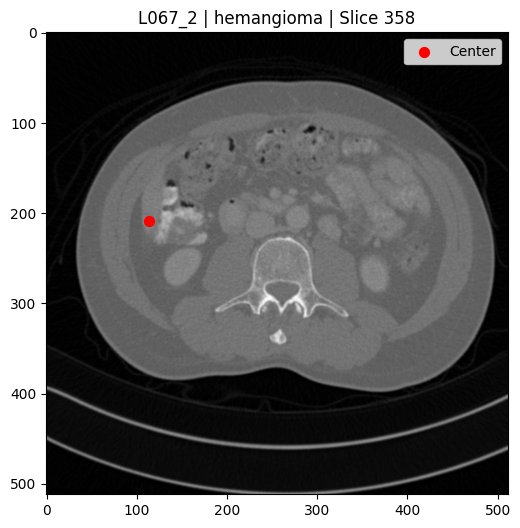

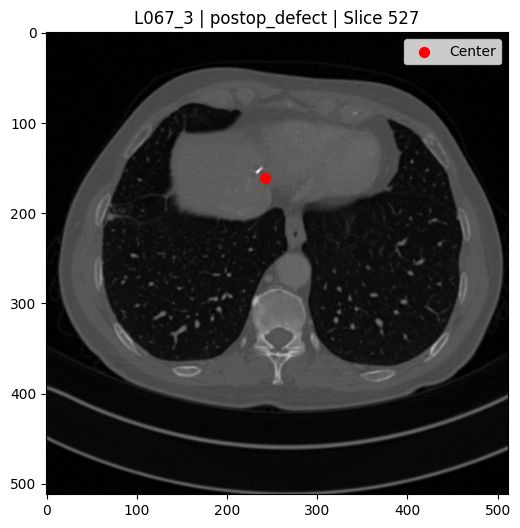

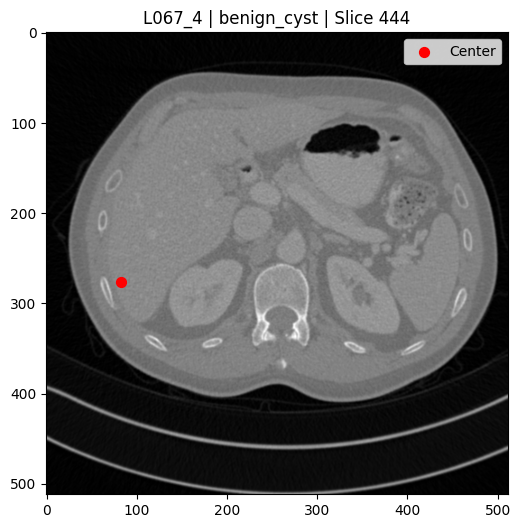

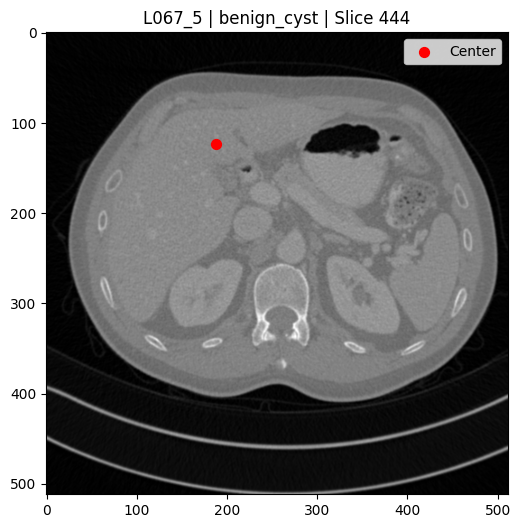

...

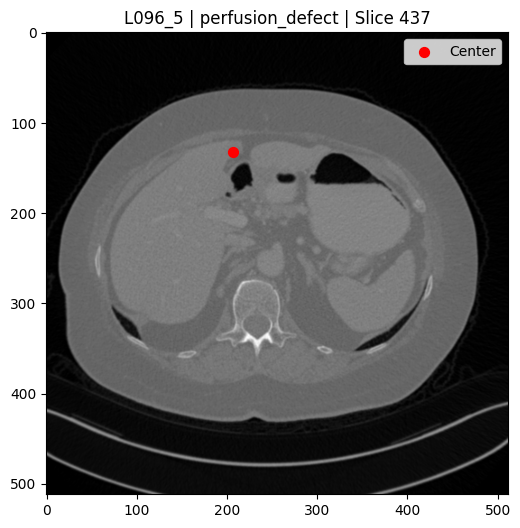

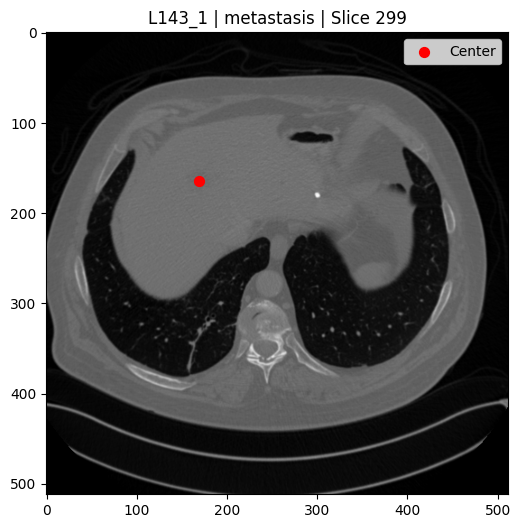

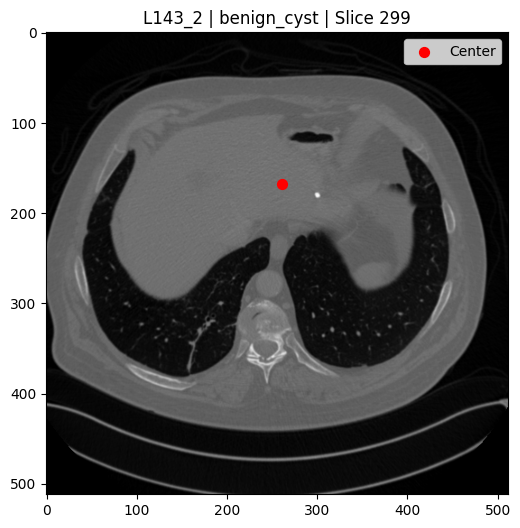

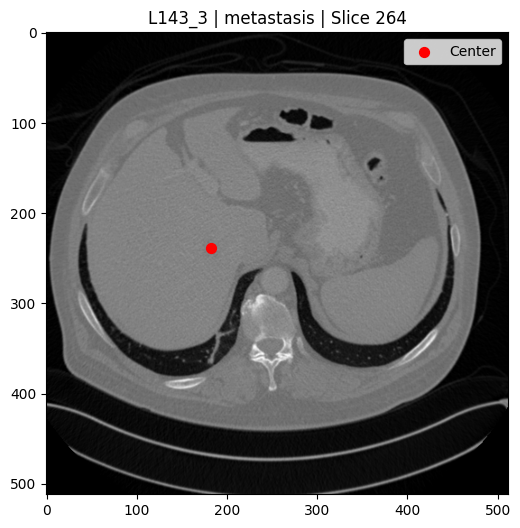

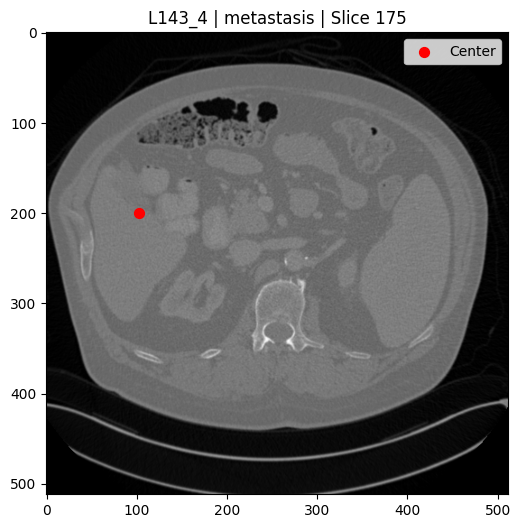

In [9]:
import os
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt

roi_data = [
    ("L067", 15.2643, [125, 247, 501], "hemangioma", "L067_1"),
    ("L067", 13.0384, [114, 209, 358], "hemangioma", "L067_2"),
    ("L067", 17.0294, [242, 161, 527], "postop_defect", "L067_3"),
    ("L067", 4.0, [83, 276, 444], "benign_cyst", "L067_4"),
    ("L067", 5.65685, [188, 123, 444], "benign_cyst", "L067_5"),
    ("L096", 23.4094, [122, 192, 495], "metastasis", "L096_1"),
    ("L096", 14.0, [197, 219, 495], "metastasis", "L096_2"),
    ("L096", 8.94427, [85, 219, 475], "hemangioma", "L096_3"),
    ("L096", 7.0, [138, 243, 468], "metastasis", "L096_4"),
    ("L096", 11.4018, [207, 132, 437], "perfusion_defect", "L096_5"),
    ("L143", 16.1555, [169, 164, 299], "metastasis", "L143_1"),
    ("L143", 4.12311, [261, 168, 299], "benign_cyst", "L143_2"),
    ("L143", 15.2643, [182, 239, 264], "metastasis", "L143_3"),
    ("L143", 9.21954, [102, 200, 175], "metastasis", "L143_4"),
]

input_dir = "/mnt/nas7/data/maria/final_features/nifti_new_dataset"

for case_name, radius_mm, center, lesion, screenshot in roi_data:
    nifti_path = os.path.join(input_dir, f"FD_{case_name}.nii")
    if not os.path.exists(nifti_path):
        print(f"File not found: {nifti_path}")
        continue

    nifti_img = nib.load(nifti_path)
    volume = nifti_img.get_fdata()
    affine = nifti_img.affine

    center = np.array(center).astype(int)

    # Select the axial slice (Z direction) at center[2]
    z = center[2]
    slice_img = volume[z, :, :]

    # Plot with the center marked
    plt.figure(figsize=(6, 6))
    plt.imshow(slice_img, cmap='gray')
    plt.scatter(center[0], center[1], c='red', s=50, label='Center')
    plt.title(f"{screenshot} | {lesion} | Slice {z}")
    plt.legend()
    plt.show()


zoom [0.99994353 0.99994353 1.00000001]
original spacing [0.6640625  0.6640625  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [125 247 501] new center [124 246 501]
shape vol (512, 512, 560)
shape new vol (512, 512, 560)


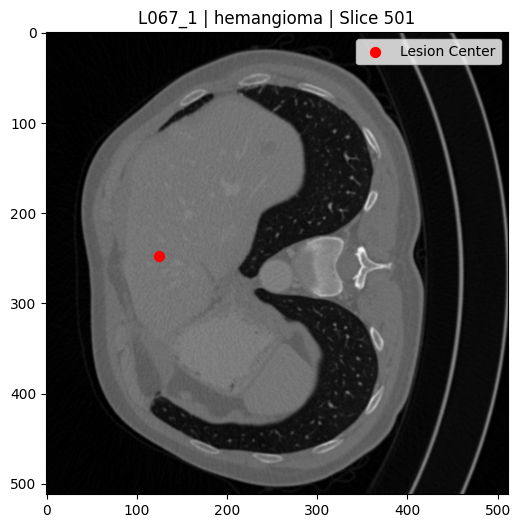

z 501 new z 501


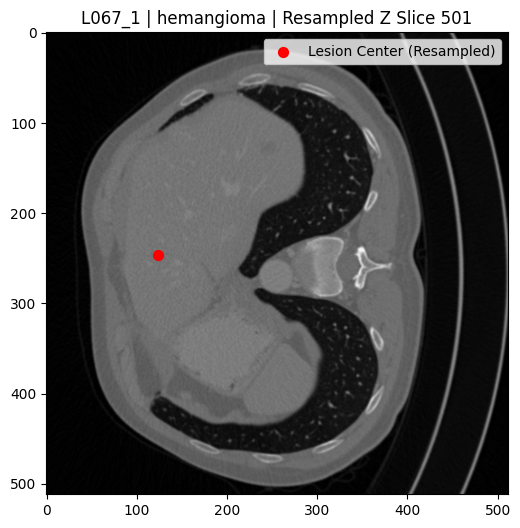

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 560)
center [125 247 501]
min corner [ 92 214 485]
max corner [156 278 517]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L067_1_hemangioma_patch_resampled.nii


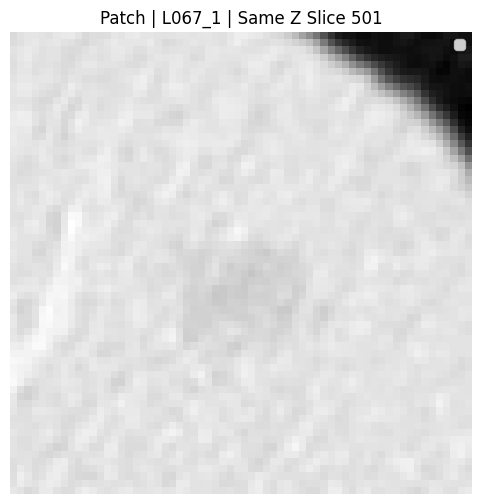

zoom [0.99994353 0.99994353 1.00000001]
original spacing [0.6640625  0.6640625  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [114 209 358] new center [113 208 358]
shape vol (512, 512, 560)
shape new vol (512, 512, 560)


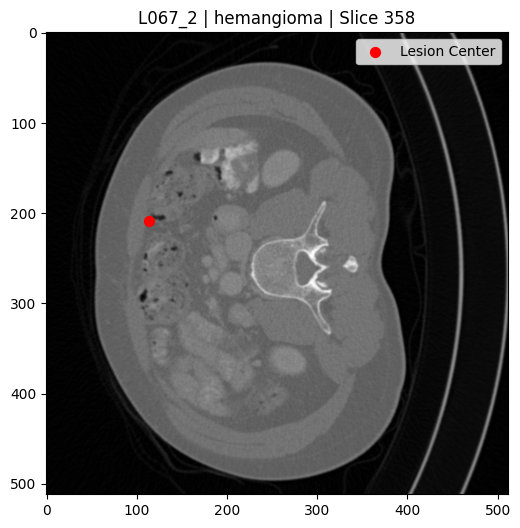

z 358 new z 358


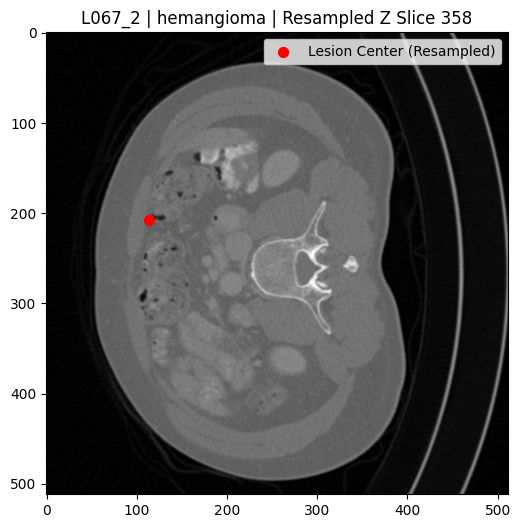

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 560)
center [114 209 358]
min corner [ 81 176 342]
max corner [145 240 374]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L067_2_hemangioma_patch_resampled.nii


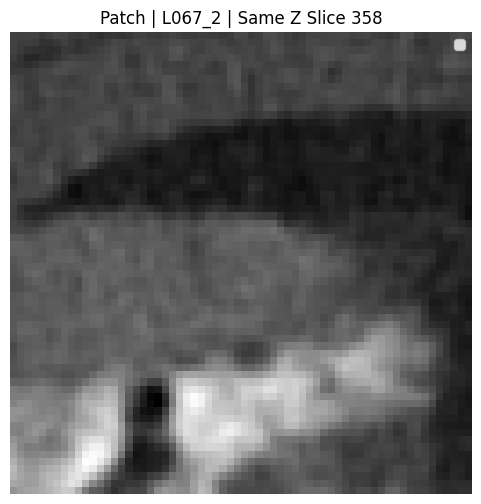

zoom [0.99994353 0.99994353 1.00000001]
original spacing [0.6640625  0.6640625  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [242 161 527] new center [241 160 527]
shape vol (512, 512, 560)
shape new vol (512, 512, 560)


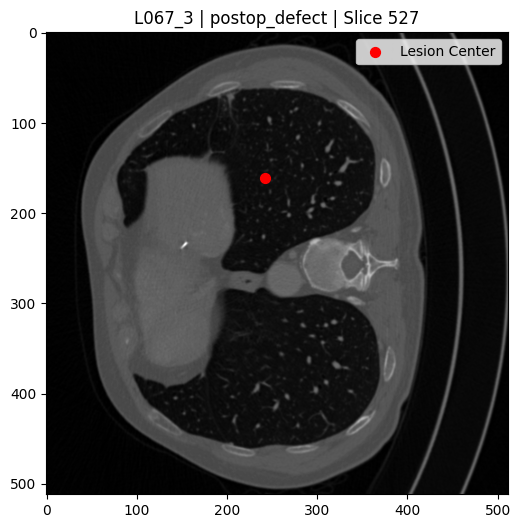

z 527 new z 527


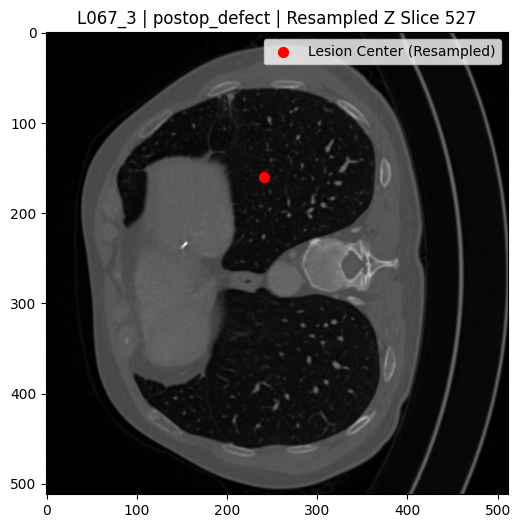

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 560)
center [242 161 527]
min corner [209 128 511]
max corner [273 192 543]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L067_3_postop_defect_patch_resampled.nii


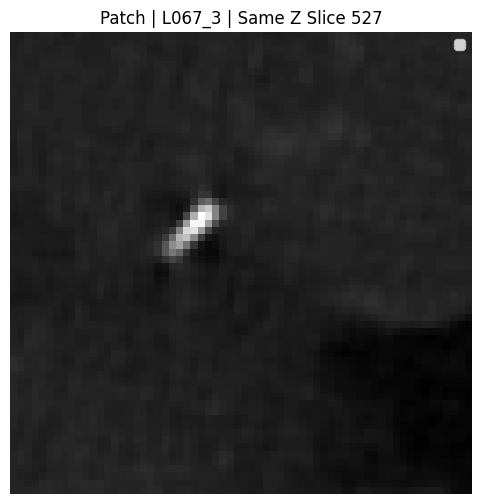

zoom [0.99994353 0.99994353 1.00000001]
original spacing [0.6640625  0.6640625  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [ 83 276 444] new center [ 82 275 444]
shape vol (512, 512, 560)
shape new vol (512, 512, 560)


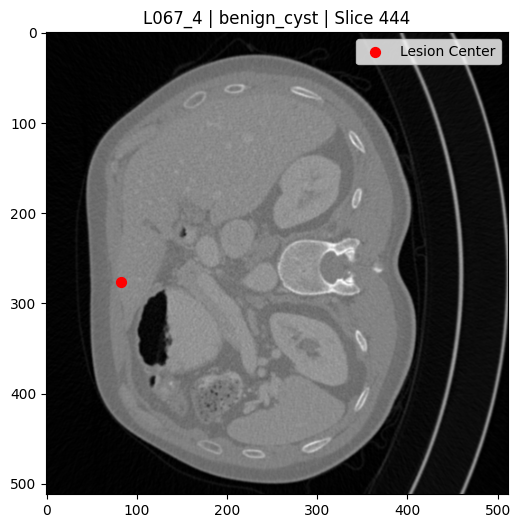

z 444 new z 444


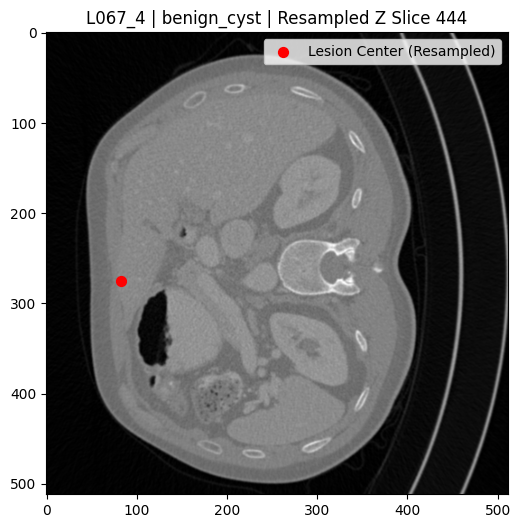

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 560)
center [ 83 276 444]
min corner [ 50 243 428]
max corner [114 307 460]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L067_4_benign_cyst_patch_resampled.nii


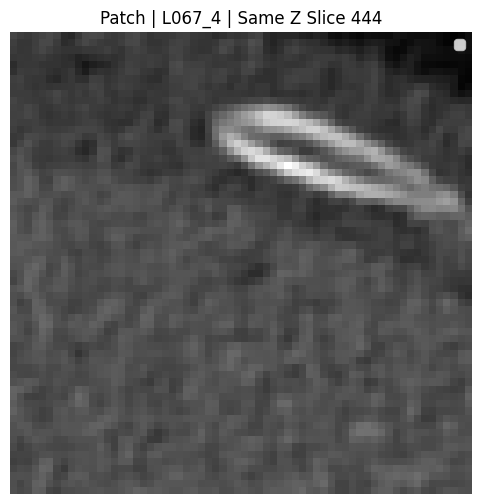

zoom [0.99994353 0.99994353 1.00000001]
original spacing [0.6640625  0.6640625  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [188 123 444] new center [187 122 444]
shape vol (512, 512, 560)
shape new vol (512, 512, 560)


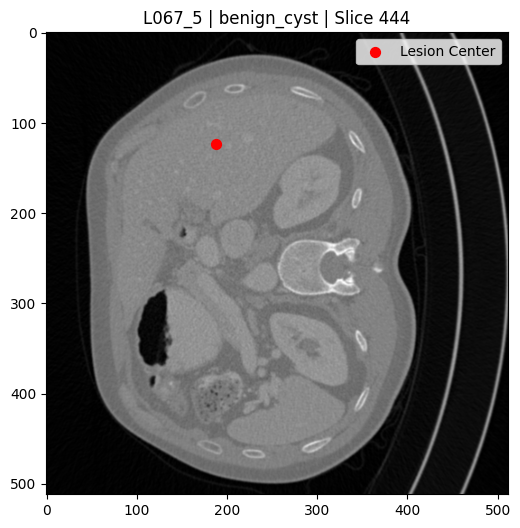

z 444 new z 444


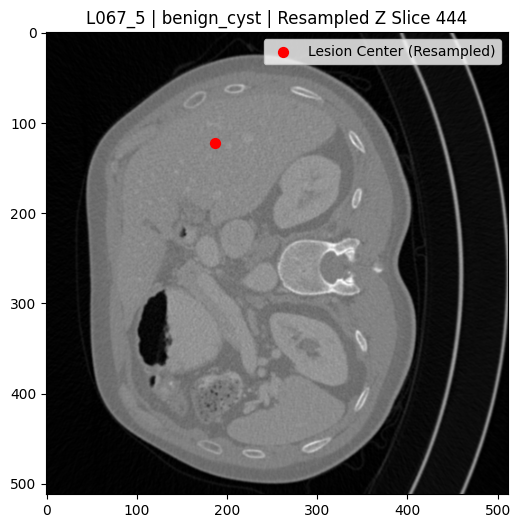

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 560)
center [188 123 444]
min corner [155  90 428]
max corner [219 154 460]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L067_5_benign_cyst_patch_resampled.nii


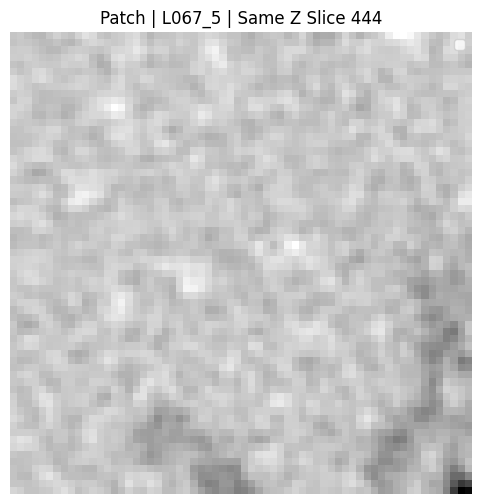

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [122 192 495] new center [136 214 495]
shape vol (512, 512, 823)
shape new vol (572, 572, 823)


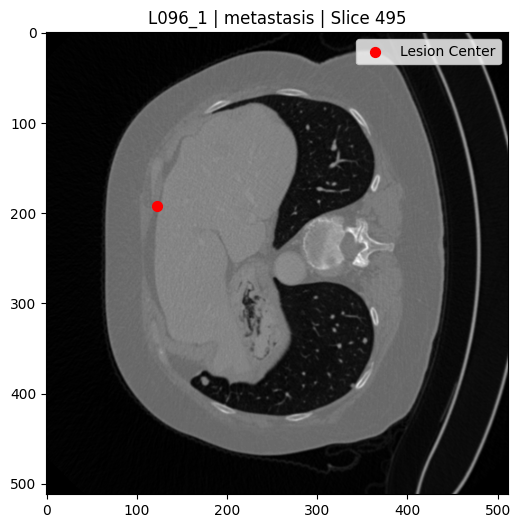

z 495 new z 495


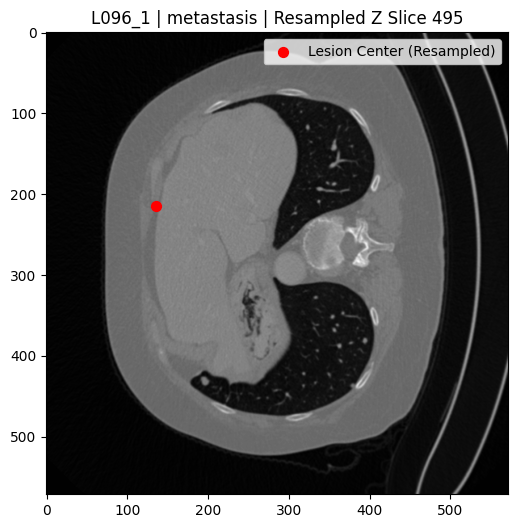

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 823)
center [122 192 495]
min corner [104 182 479]
max corner [168 246 511]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L096_1_metastasis_patch_resampled.nii


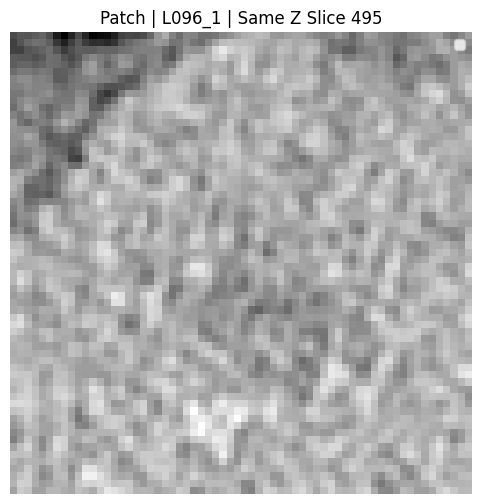

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [197 219 495] new center [220 244 495]
shape vol (512, 512, 823)
shape new vol (572, 572, 823)


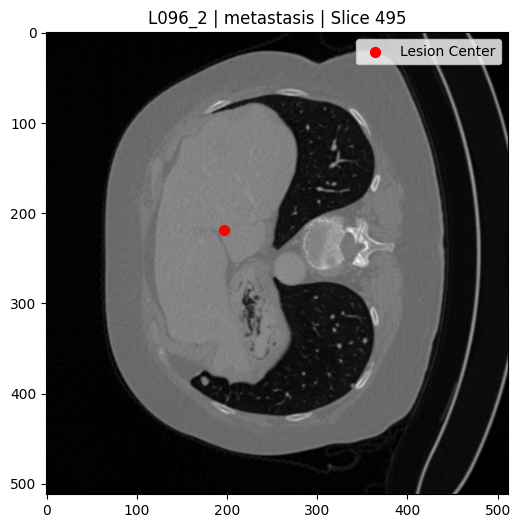

z 495 new z 495


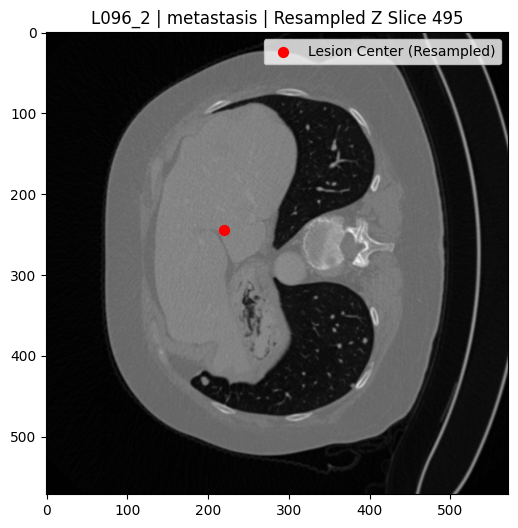

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 823)
center [197 219 495]
min corner [188 212 479]
max corner [252 276 511]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L096_2_metastasis_patch_resampled.nii


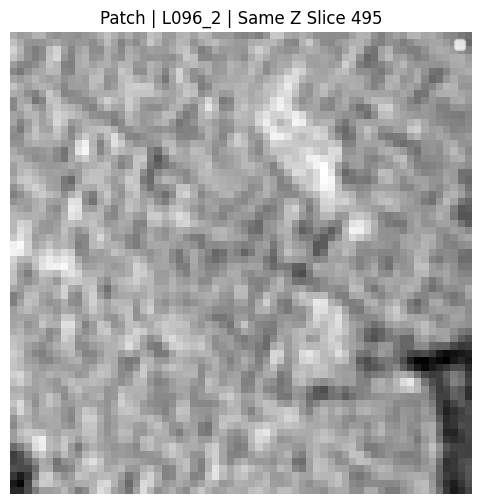

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [ 85 219 475] new center [ 94 244 475]
shape vol (512, 512, 823)
shape new vol (572, 572, 823)


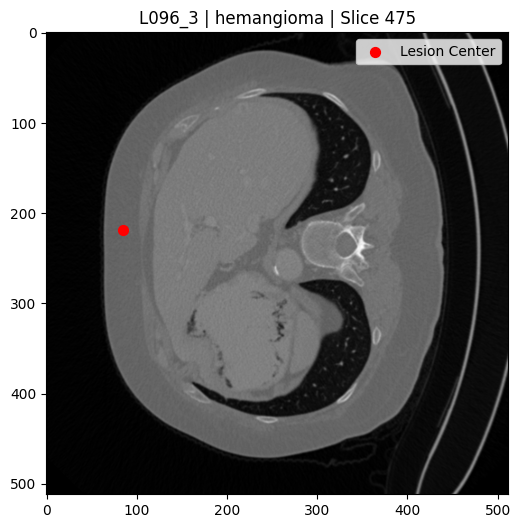

z 475 new z 475


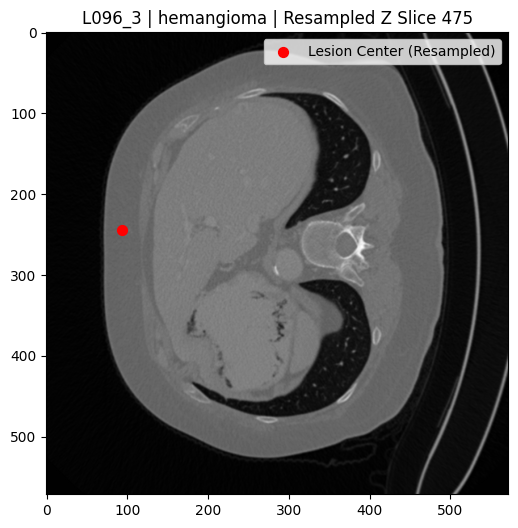

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 823)
center [ 85 219 475]
min corner [ 62 212 459]
max corner [126 276 491]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L096_3_hemangioma_patch_resampled.nii


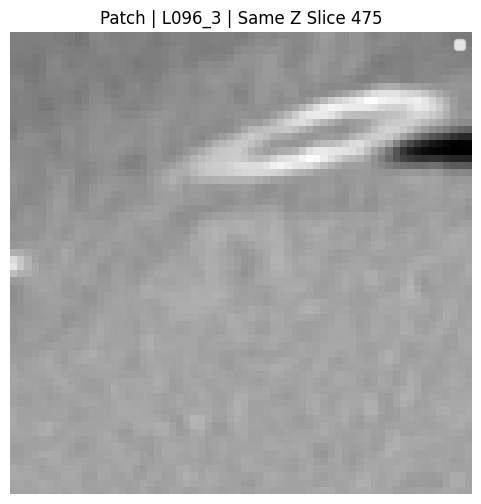

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [138 243 468] new center [154 271 468]
shape vol (512, 512, 823)
shape new vol (572, 572, 823)


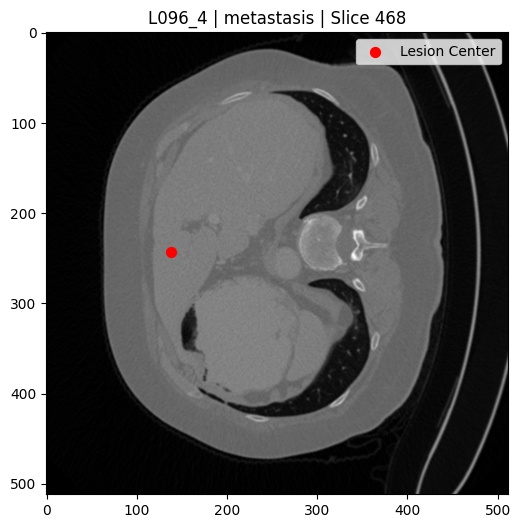

z 468 new z 468


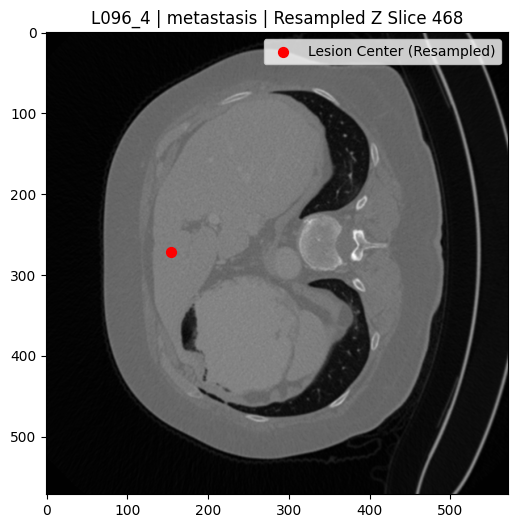

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 823)
center [138 243 468]
min corner [122 239 452]
max corner [186 303 484]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L096_4_metastasis_patch_resampled.nii


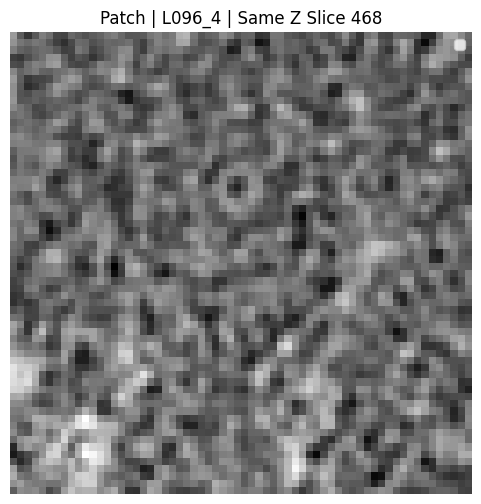

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [207 132 437] new center [231 147 437]
shape vol (512, 512, 823)
shape new vol (572, 572, 823)


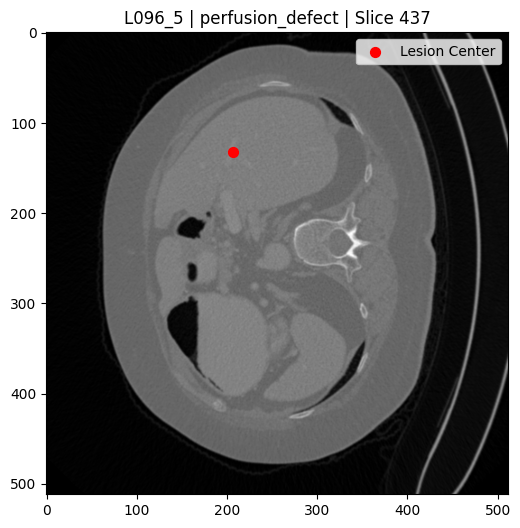

z 437 new z 437


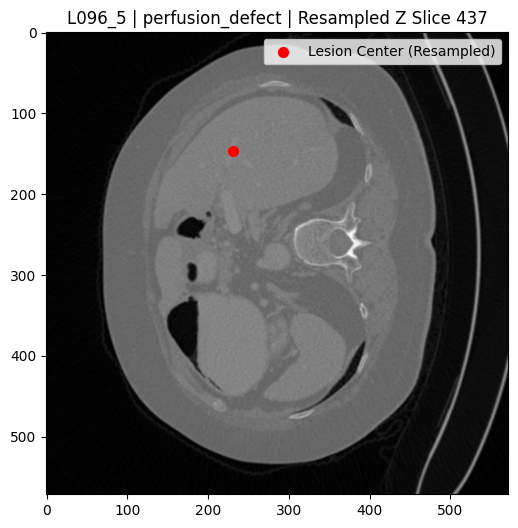

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 823)
center [207 132 437]
min corner [199 115 421]
max corner [263 179 453]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L096_5_perfusion_defect_patch_resampled.nii


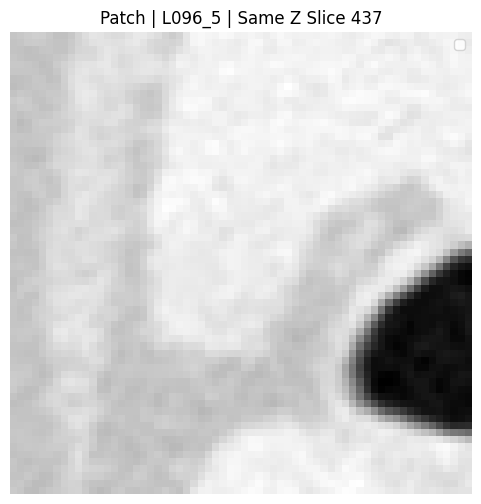

zoom [1.23522436 1.23522436 1.00000001]
original spacing [0.8203125  0.8203125  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [169 164 299] new center [208 202 299]
shape vol (512, 512, 585)
shape new vol (632, 632, 585)


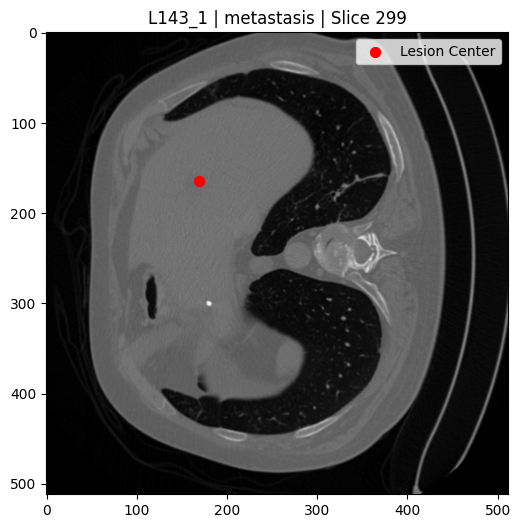

z 299 new z 299


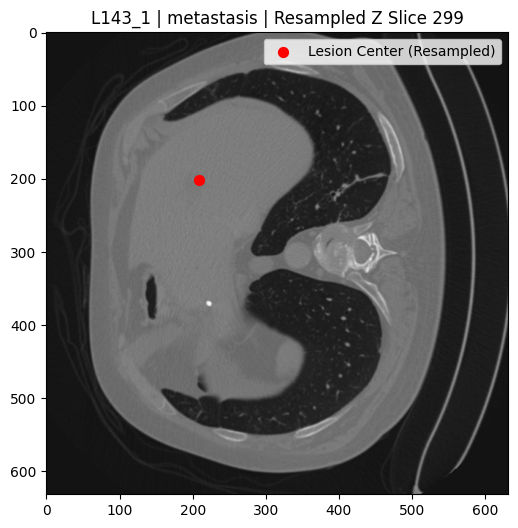

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 585)
center [169 164 299]
min corner [176 170 283]
max corner [240 234 315]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L143_1_metastasis_patch_resampled.nii


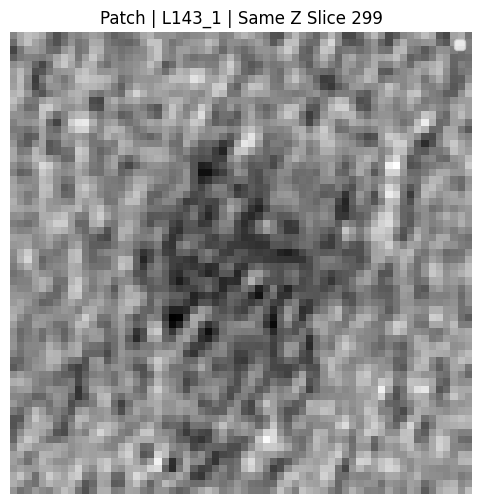

zoom [1.23522436 1.23522436 1.00000001]
original spacing [0.8203125  0.8203125  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [261 168 299] new center [322 207 299]
shape vol (512, 512, 585)
shape new vol (632, 632, 585)


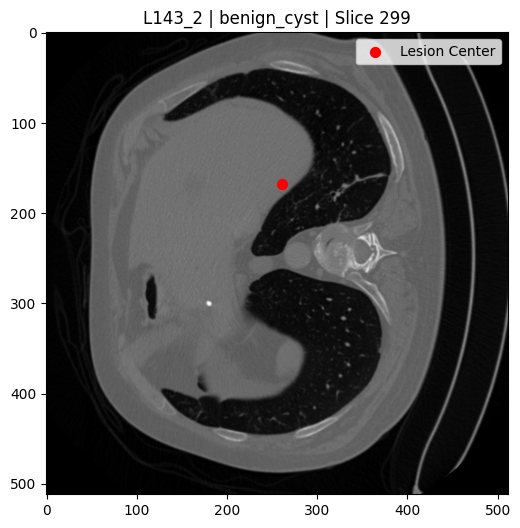

z 299 new z 299


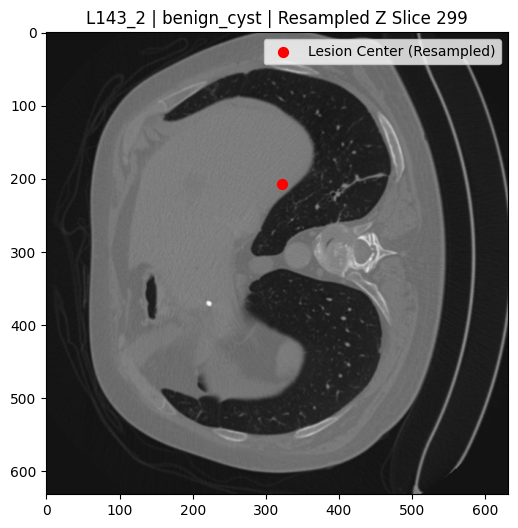

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 585)
center [261 168 299]
min corner [290 175 283]
max corner [354 239 315]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L143_2_benign_cyst_patch_resampled.nii


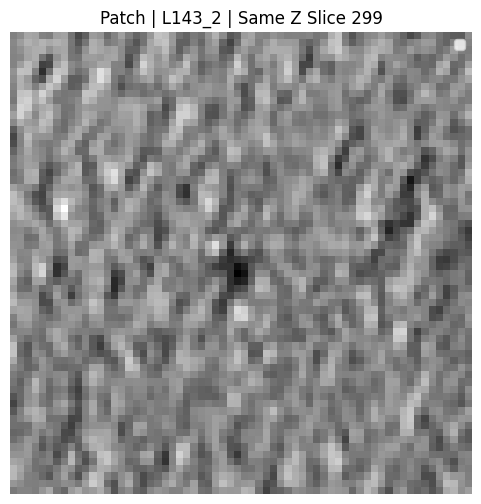

zoom [1.23522436 1.23522436 1.00000001]
original spacing [0.8203125  0.8203125  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [182 239 264] new center [224 295 264]
shape vol (512, 512, 585)
shape new vol (632, 632, 585)


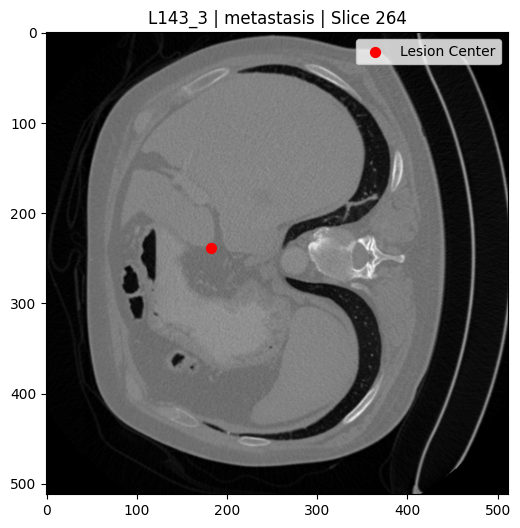

z 264 new z 264


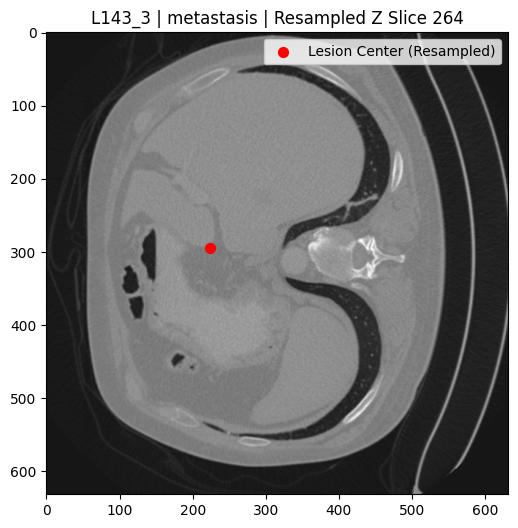

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 585)
center [182 239 264]
min corner [192 263 248]
max corner [256 327 280]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L143_3_metastasis_patch_resampled.nii


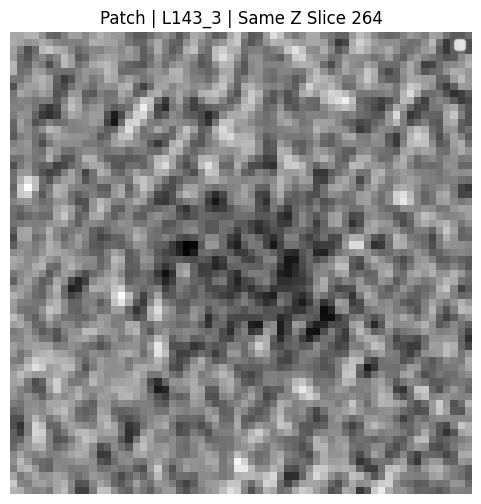

zoom [1.23522436 1.23522436 1.00000001]
original spacing [0.8203125  0.8203125  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [102 200 175] new center [125 247 175]
shape vol (512, 512, 585)
shape new vol (632, 632, 585)


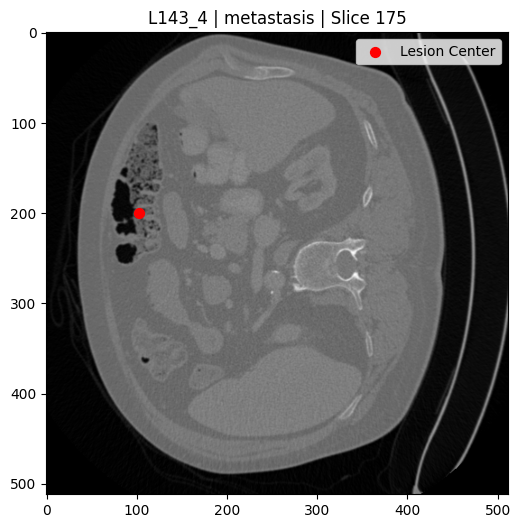

z 175 new z 175


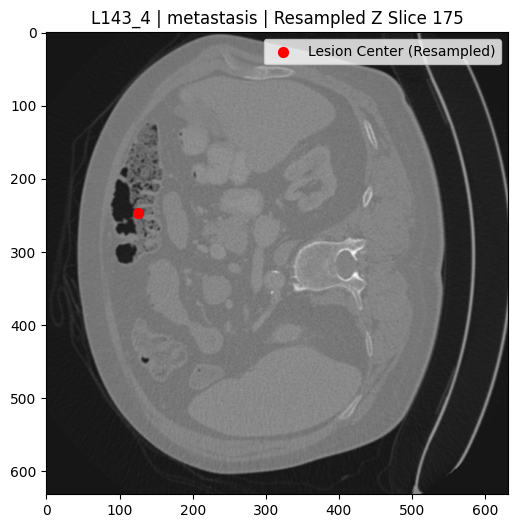

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 585)
center [102 200 175]
min corner [ 93 215 159]
max corner [157 279 191]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L143_4_metastasis_patch_resampled.nii


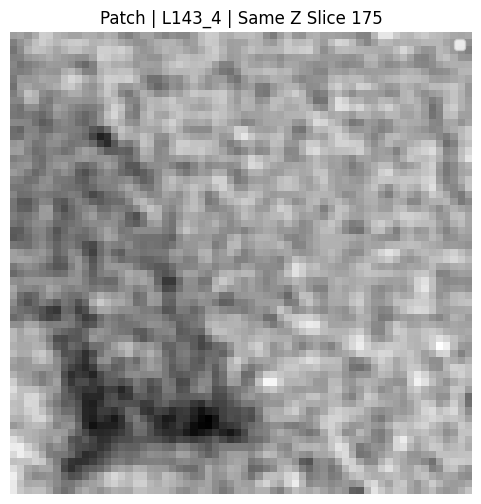

zoom [1.05876374 1.05876374 1.00000001]
original spacing [0.703125   0.703125   0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [221 208 518] new center [233 220 518]
shape vol (512, 512, 600)
shape new vol (542, 542, 600)


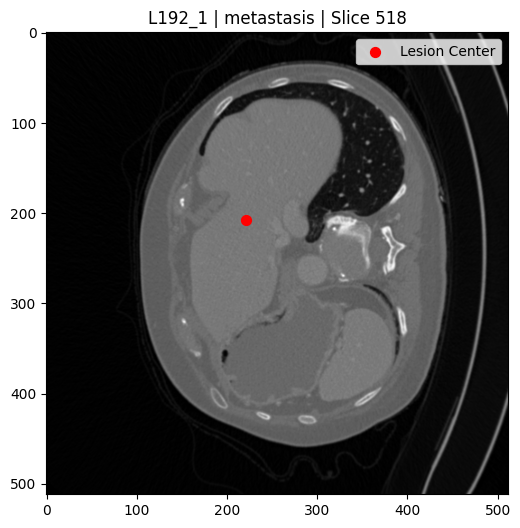

z 518 new z 518


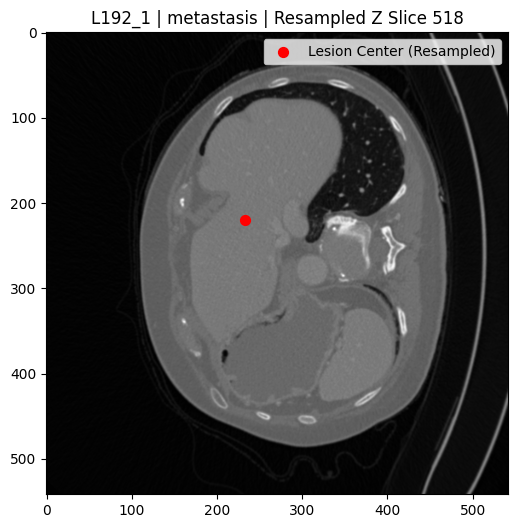

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 600)
center [221 208 518]
min corner [201 188 502]
max corner [265 252 534]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L192_1_metastasis_patch_resampled.nii


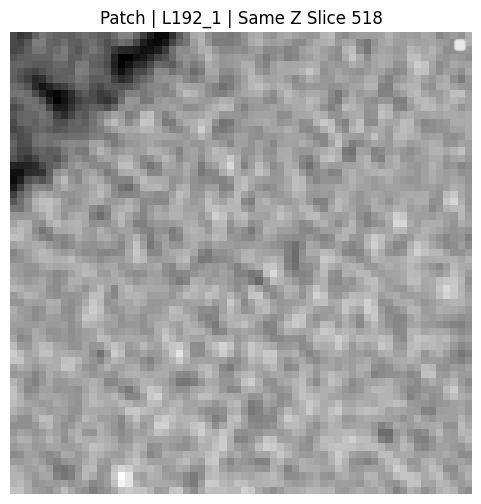

zoom [1.05876374 1.05876374 1.00000001]
original spacing [0.703125   0.703125   0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [200 229 484] new center [211 242 484]
shape vol (512, 512, 600)
shape new vol (542, 542, 600)


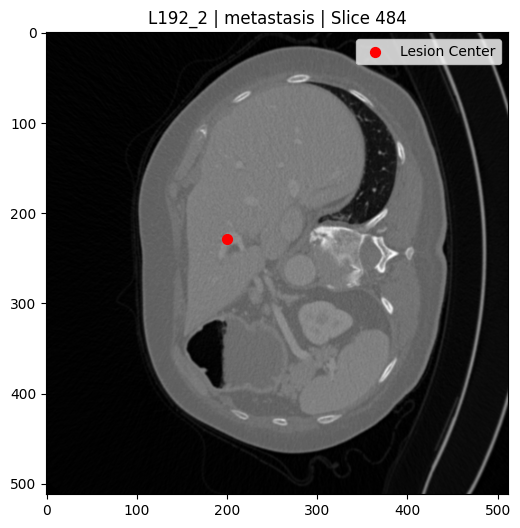

z 484 new z 484


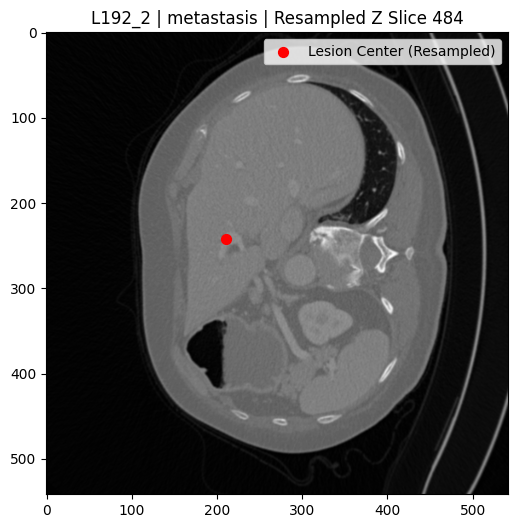

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 600)
center [200 229 484]
min corner [179 210 468]
max corner [243 274 500]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L192_2_metastasis_patch_resampled.nii


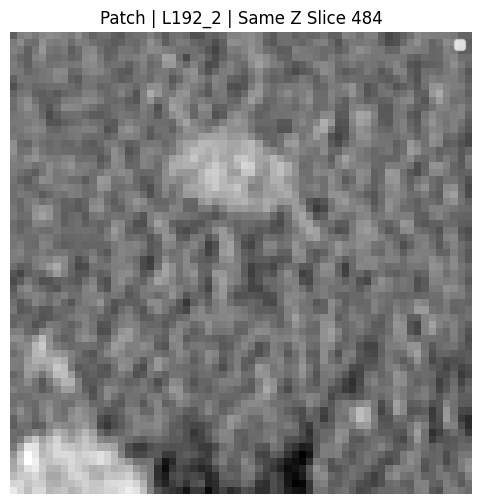

zoom [1.05876374 1.05876374 1.00000001]
original spacing [0.703125   0.703125   0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [103 336 464] new center [109 355 464]
shape vol (512, 512, 600)
shape new vol (542, 542, 600)


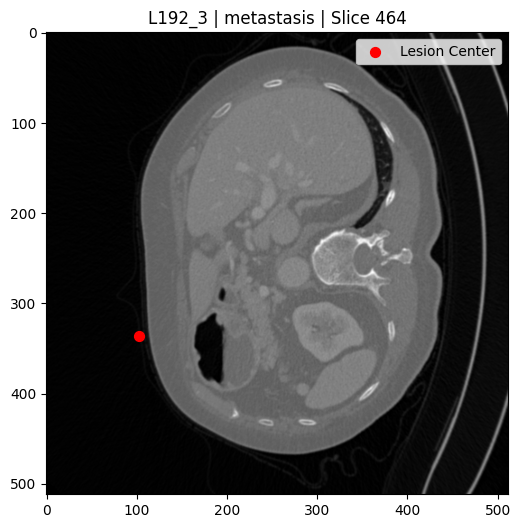

z 464 new z 464


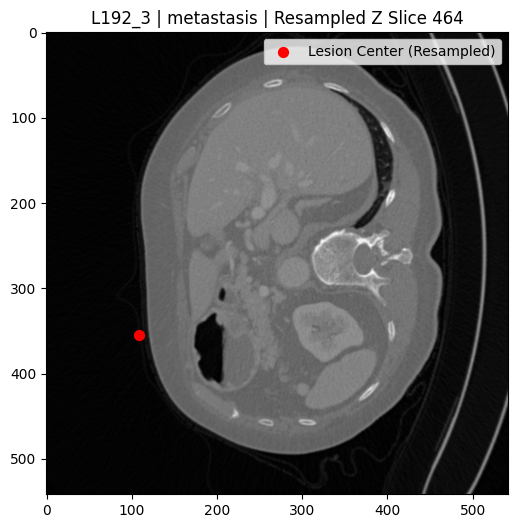

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 600)
center [103 336 464]
min corner [ 77 323 448]
max corner [141 387 480]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L192_3_metastasis_patch_resampled.nii


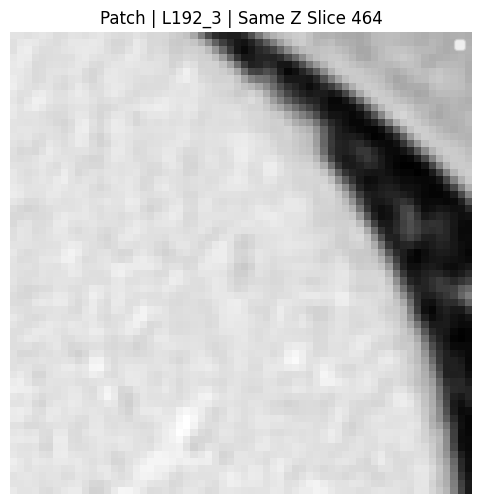

zoom [1.05876374 1.05876374 1.00000001]
original spacing [0.703125   0.703125   0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [120 246 407] new center [127 260 407]
shape vol (512, 512, 600)
shape new vol (542, 542, 600)


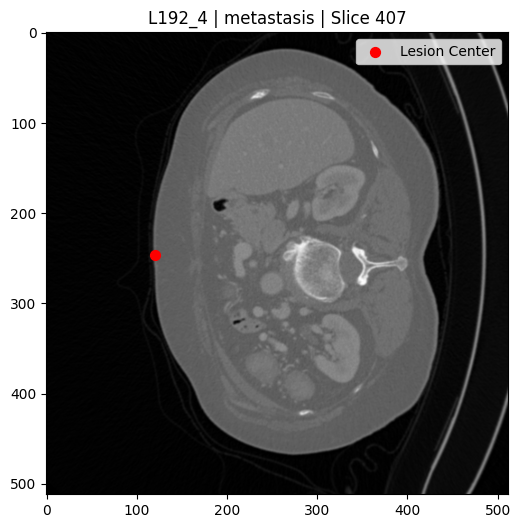

z 407 new z 407


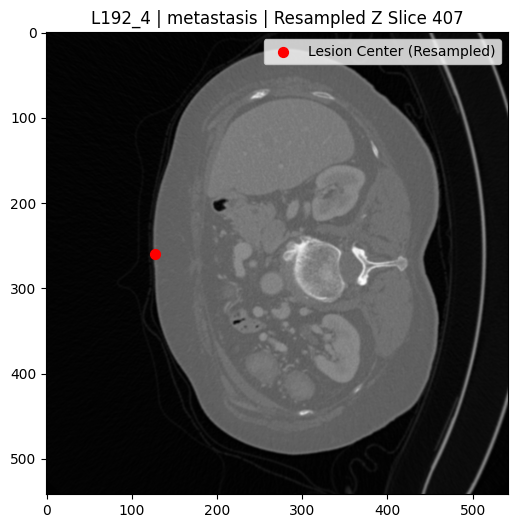

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 600)
center [120 246 407]
min corner [ 95 228 391]
max corner [159 292 423]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L192_4_metastasis_patch_resampled.nii


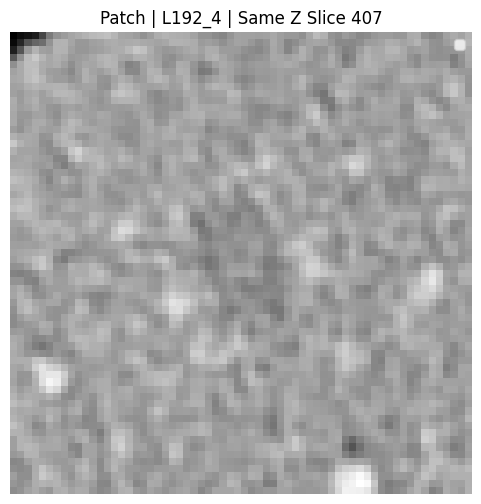

zoom [1.05876374 1.05876374 1.00000001]
original spacing [0.703125   0.703125   0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [139 321 407] new center [147 339 407]
shape vol (512, 512, 600)
shape new vol (542, 542, 600)


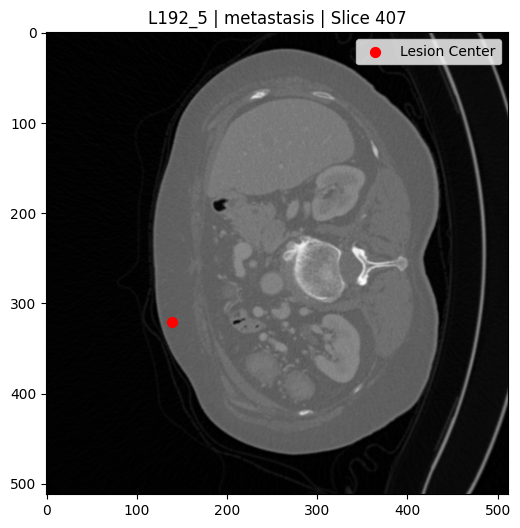

z 407 new z 407


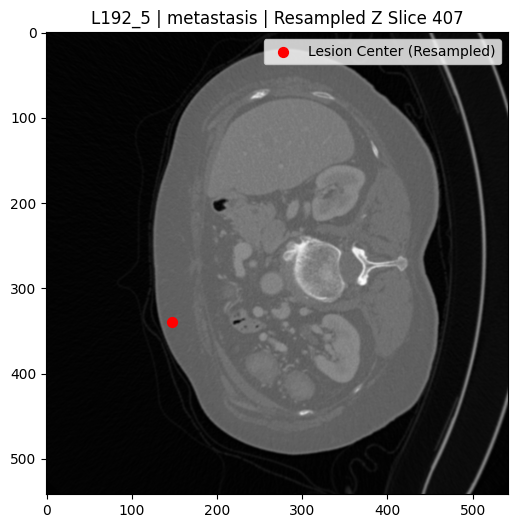

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 600)
center [139 321 407]
min corner [115 307 391]
max corner [179 371 423]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L192_5_metastasis_patch_resampled.nii


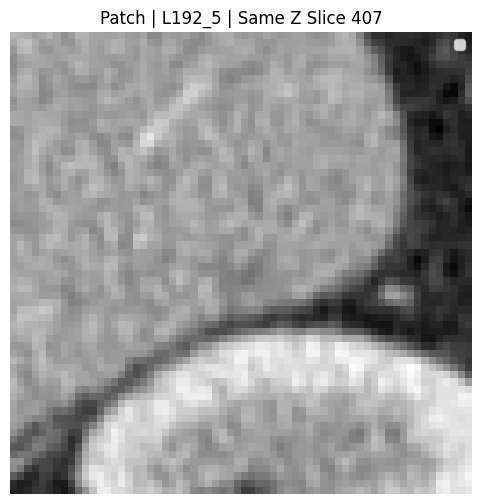

zoom [0.99994353 0.99994353 1.00000001]
original spacing [0.6640625  0.6640625  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [177 140 493] new center [176 139 493]
shape vol (512, 512, 525)
shape new vol (512, 512, 525)


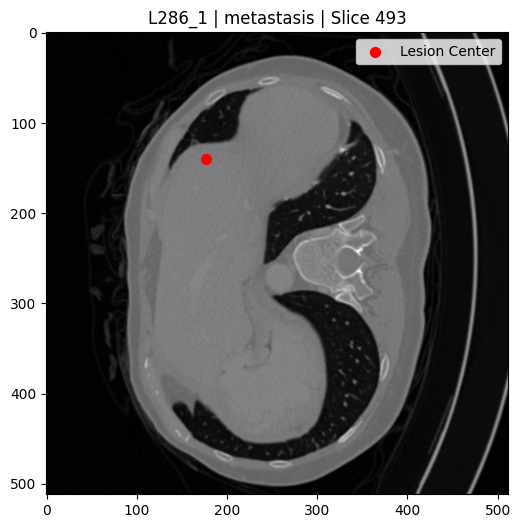

z 493 new z 493


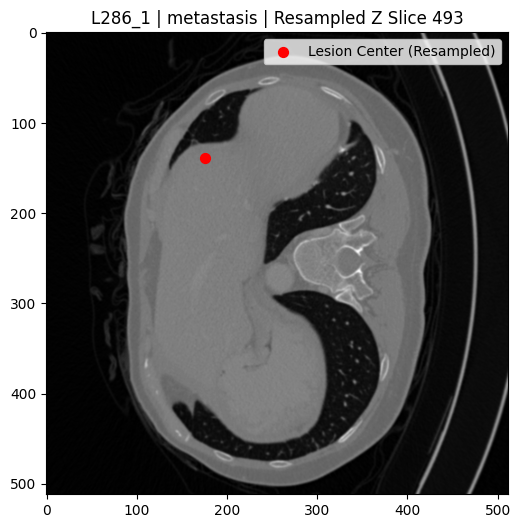

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 525)
center [177 140 493]
min corner [144 107 477]
max corner [208 171 509]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L286_1_metastasis_patch_resampled.nii


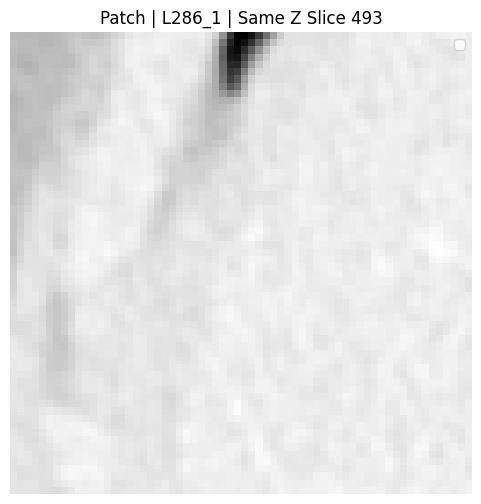

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [152 271 560] new center [169 302 560]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)


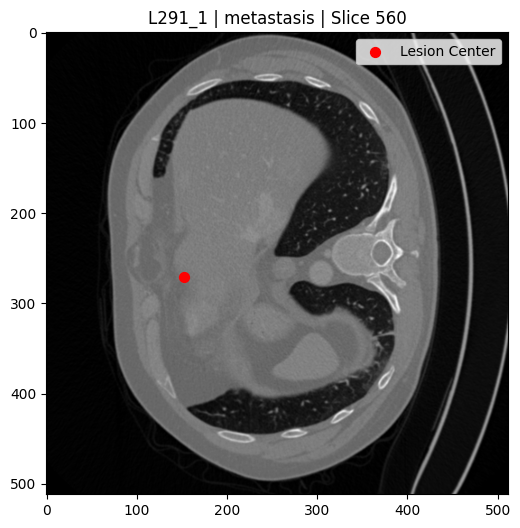

z 560 new z 560


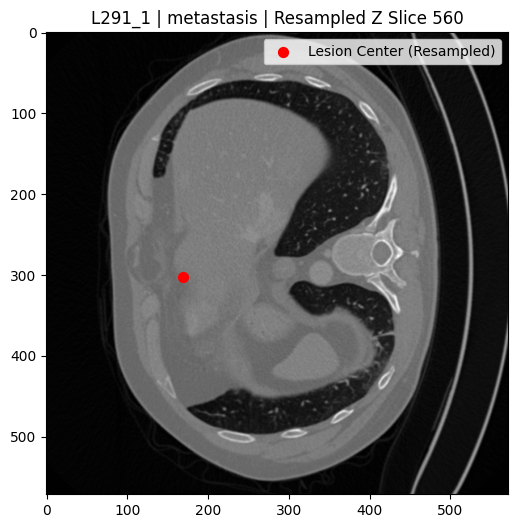

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [152 271 560]
min corner [137 270 544]
max corner [201 334 576]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L291_1_metastasis_patch_resampled.nii


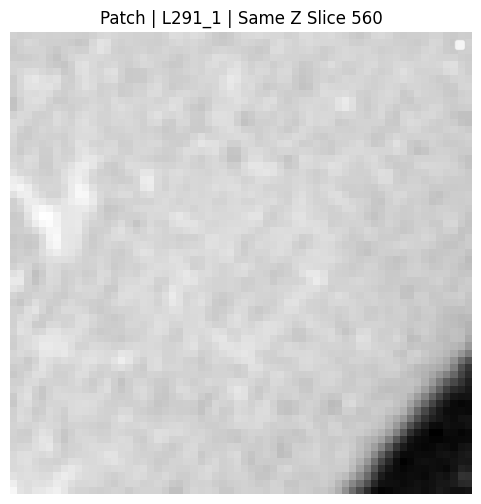

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [164 154 560] new center [183 172 560]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)


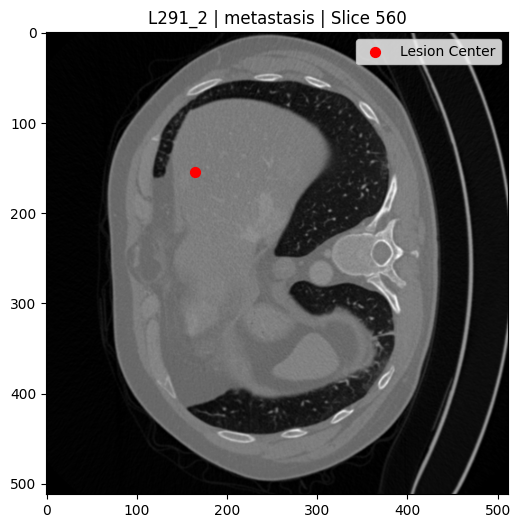

z 560 new z 560


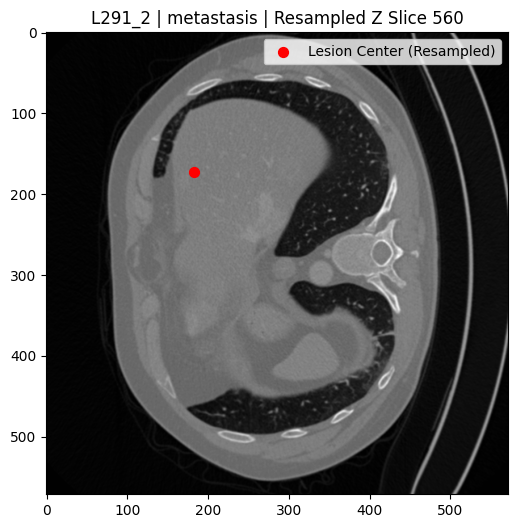

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [164 154 560]
min corner [151 140 544]
max corner [215 204 576]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L291_2_metastasis_patch_resampled.nii


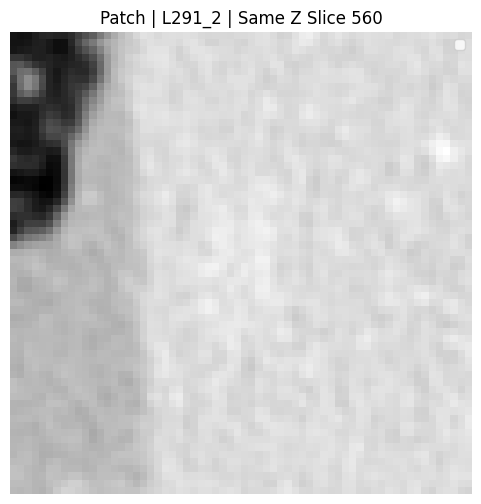

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [153 273 547] new center [170 305 547]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)


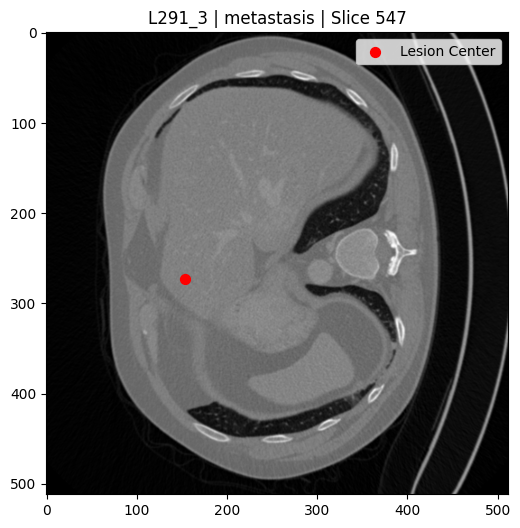

z 547 new z 547


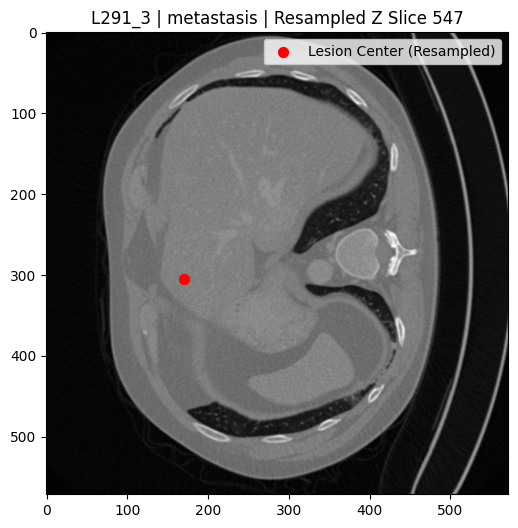

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [153 273 547]
min corner [138 273 531]
max corner [202 337 563]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L291_3_metastasis_patch_resampled.nii


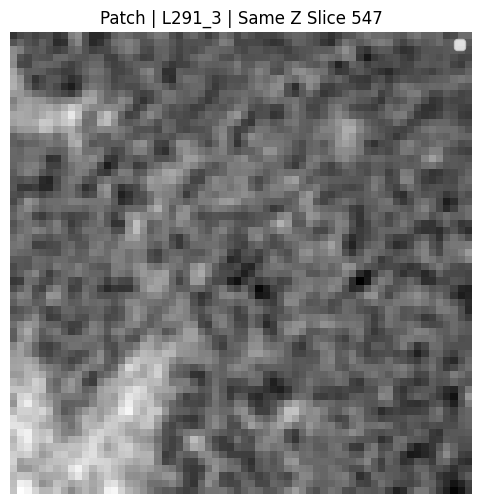

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [150 167 483] new center [167 186 483]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)


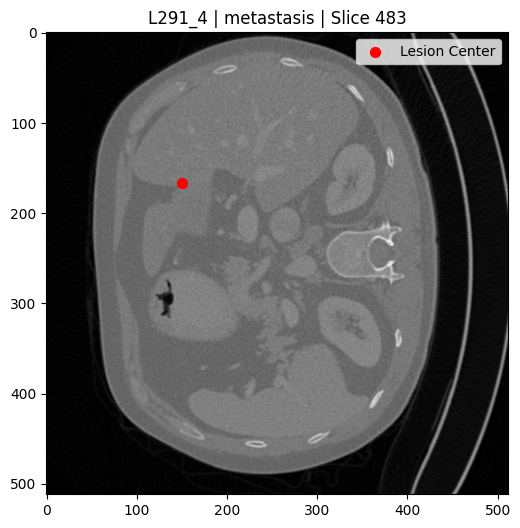

z 483 new z 483


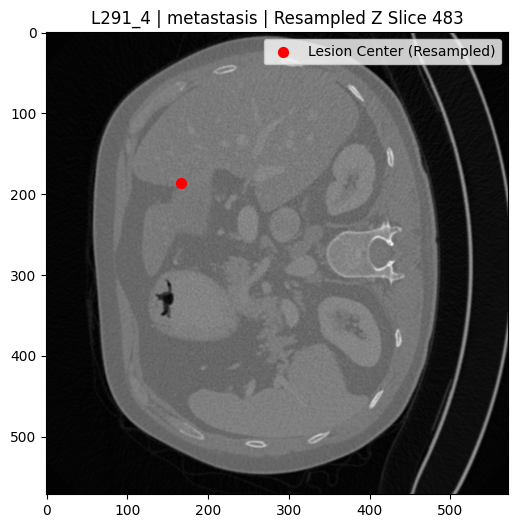

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [150 167 483]
min corner [135 154 467]
max corner [199 218 499]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L291_4_metastasis_patch_resampled.nii


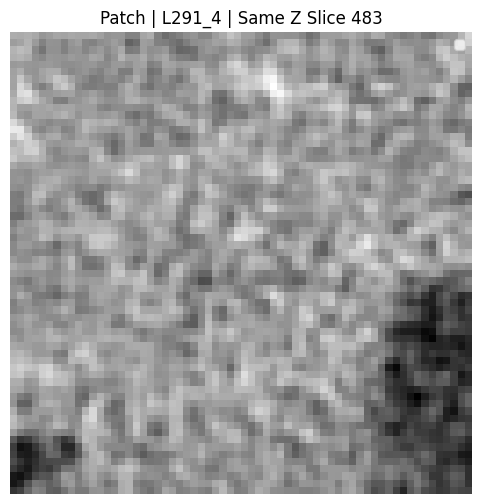

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [117 274 338] new center [130 306 338]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)


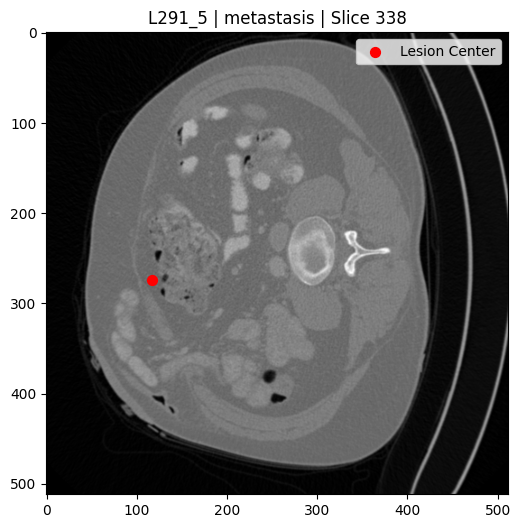

z 338 new z 338


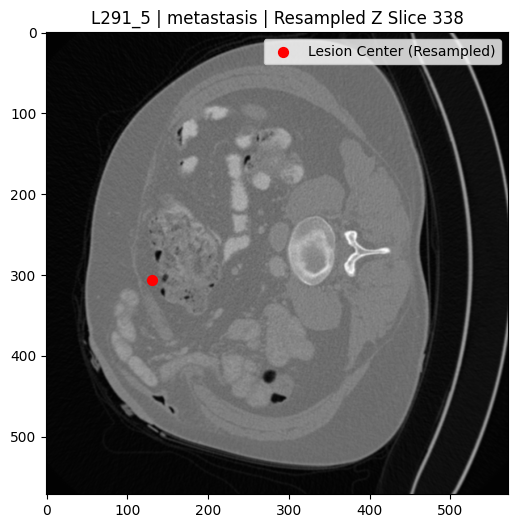

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [117 274 338]
min corner [ 98 274 322]
max corner [162 338 354]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L291_5_metastasis_patch_resampled.nii


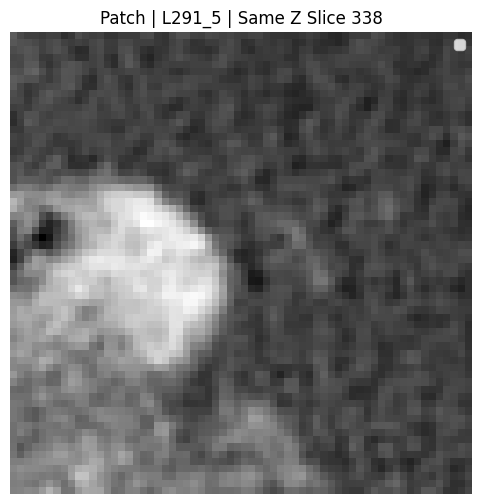

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [169 196 490] new center [188 219 490]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)


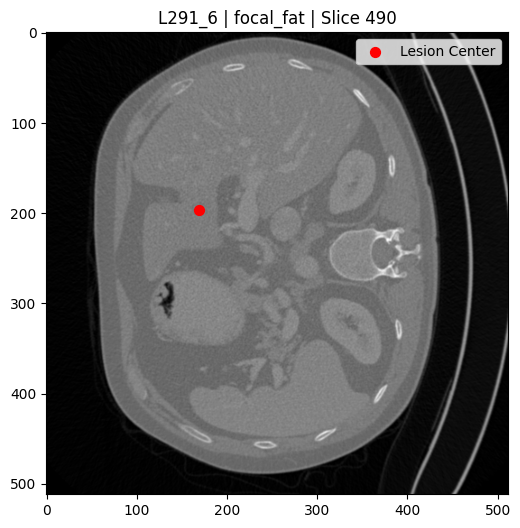

z 490 new z 490


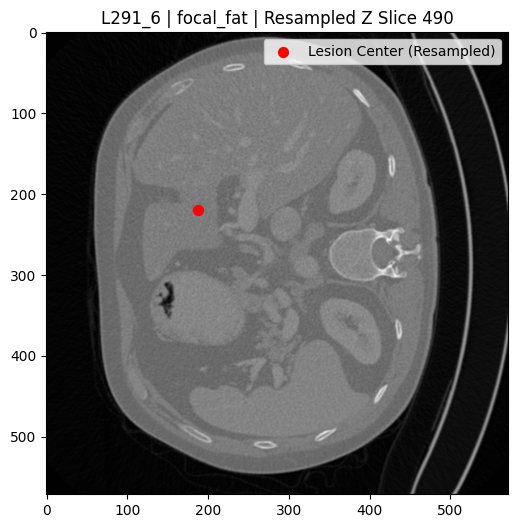

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [169 196 490]
min corner [156 187 474]
max corner [220 251 506]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L291_6_focal_fat_patch_resampled.nii


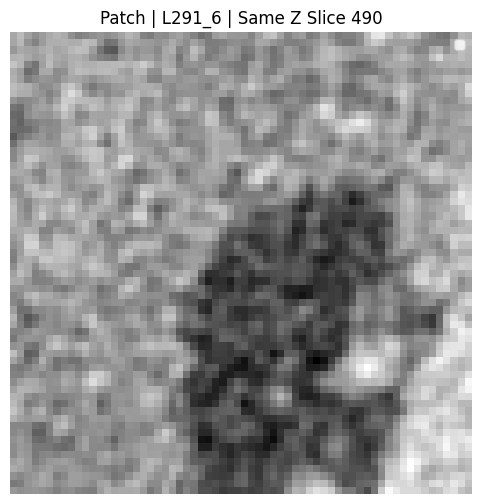

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [133 197 444] new center [148 220 444]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)


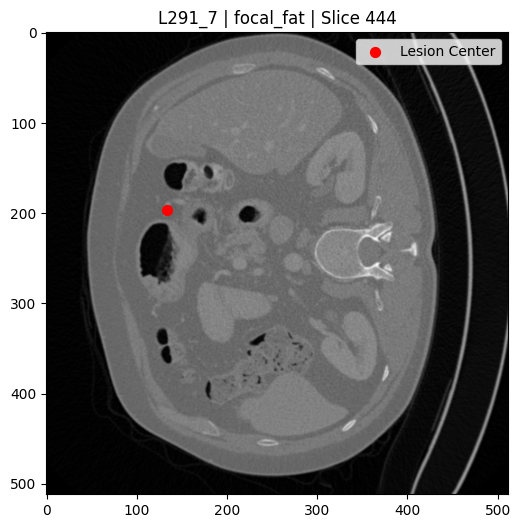

z 444 new z 444


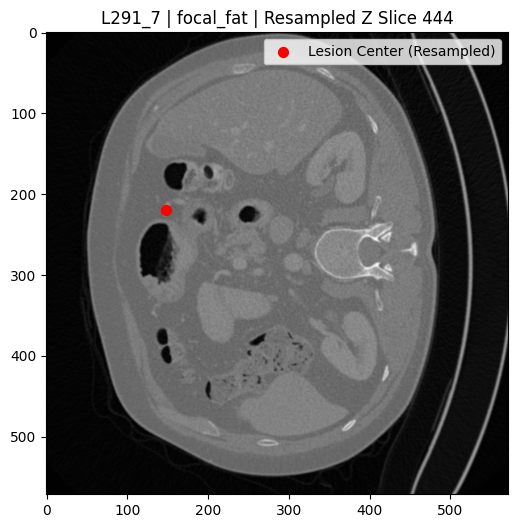

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [133 197 444]
min corner [116 188 428]
max corner [180 252 460]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L291_7_focal_fat_patch_resampled.nii


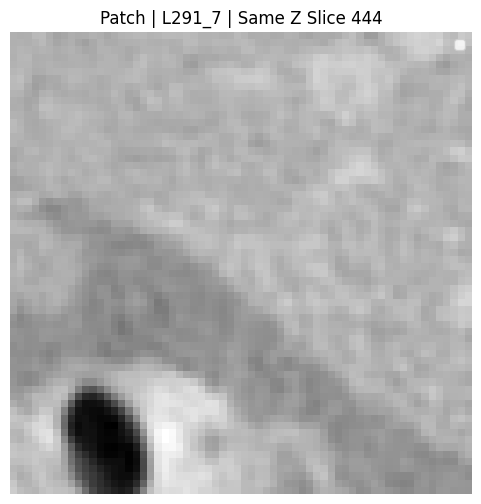

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [194 174 483] new center [216 194 483]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)


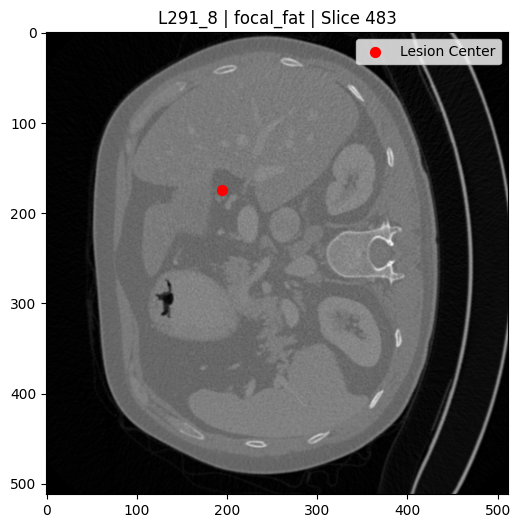

z 483 new z 483


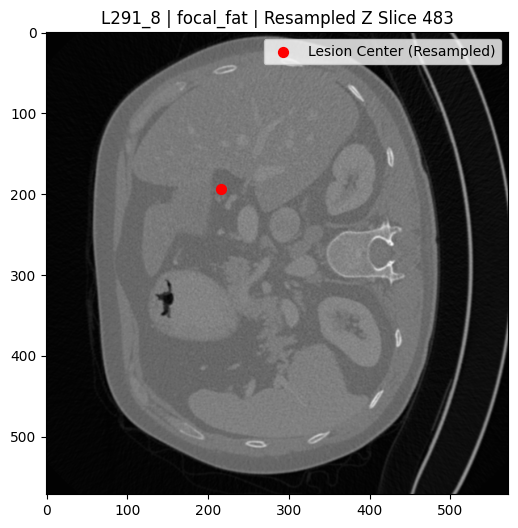

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [194 174 483]
min corner [184 162 467]
max corner [248 226 499]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L291_8_focal_fat_patch_resampled.nii


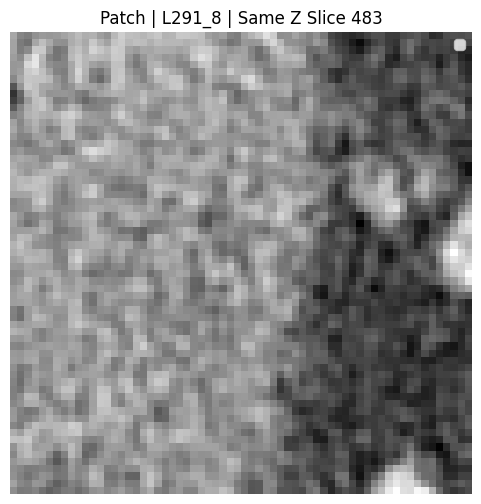

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [150 311 467] new center [167 347 467]
shape vol (512, 512, 533)
shape new vol (572, 572, 533)


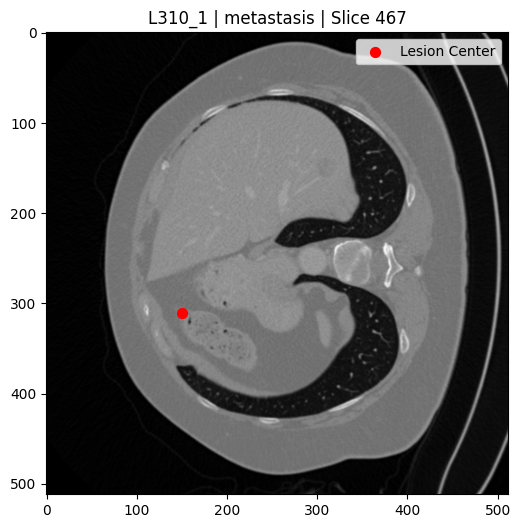

z 467 new z 467


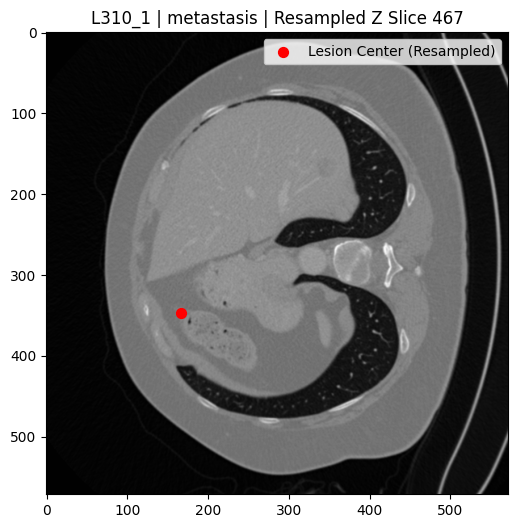

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 533)
center [150 311 467]
min corner [135 315 451]
max corner [199 379 483]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L310_1_metastasis_patch_resampled.nii


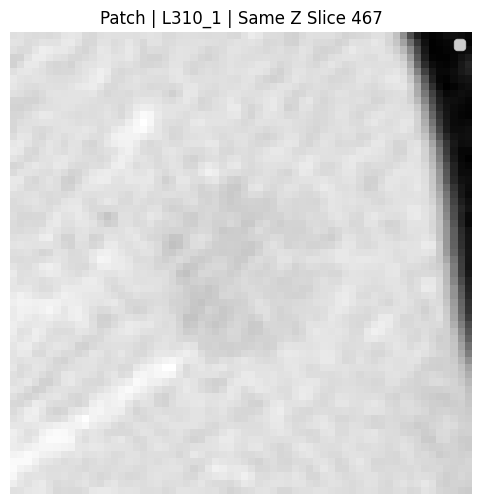

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [144 264 440] new center [160 295 440]
shape vol (512, 512, 526)
shape new vol (572, 572, 526)


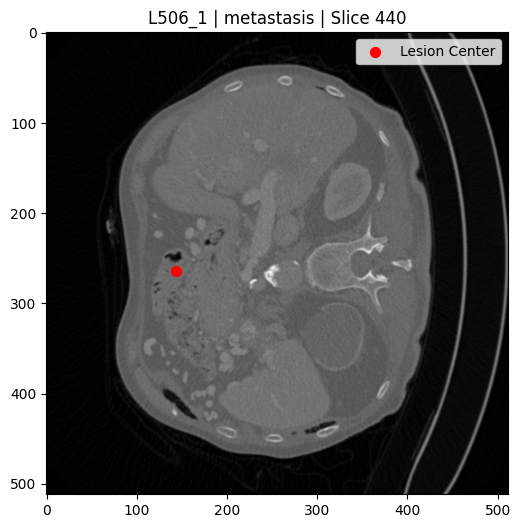

z 440 new z 440


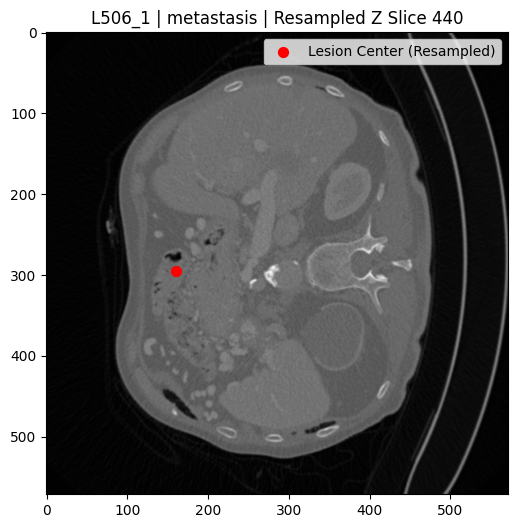

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 526)
center [144 264 440]
min corner [128 263 424]
max corner [192 327 456]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L506_1_metastasis_patch_resampled.nii


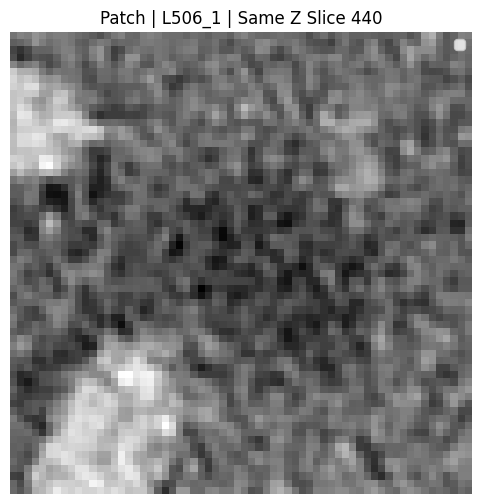

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [166 218 418] new center [185 243 418]
shape vol (512, 512, 526)
shape new vol (572, 572, 526)


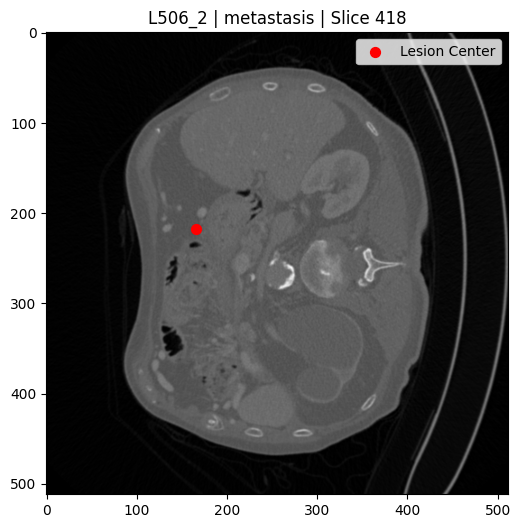

z 418 new z 418


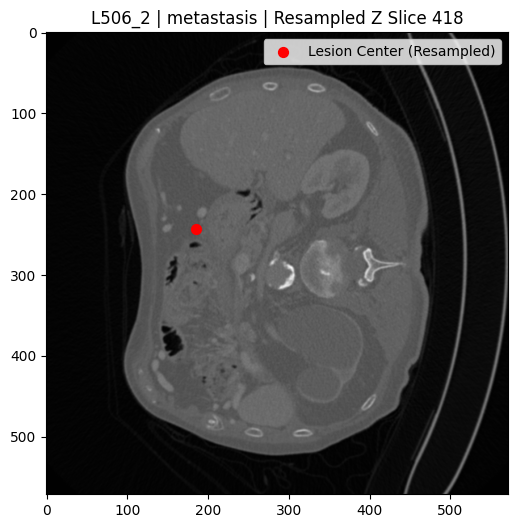

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 526)
center [166 218 418]
min corner [153 211 402]
max corner [217 275 434]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/FD_L506_2_metastasis_patch_resampled.nii


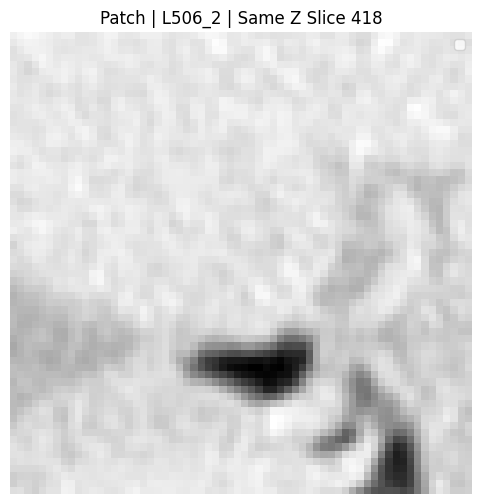

In [3]:
import os
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import zoom


roi_data = [
    ("L067", 15.2643, [125, 247, 501], "hemangioma", "L067_1"), # X Y Z
    ("L067", 13.0384, [114, 209, 358], "hemangioma", "L067_2"),
    ("L067", 17.0294, [242, 161, 527], "postop_defect", "L067_3"),
    ("L067", 4.0, [83, 276, 444], "benign_cyst", "L067_4"),
    ("L067", 5.65685, [188, 123, 444], "benign_cyst", "L067_5"),
    ("L096", 23.4094, [122, 192, 495], "metastasis", "L096_1"),
    ("L096", 14.0, [197, 219, 495], "metastasis", "L096_2"),
    ("L096", 8.94427, [85, 219, 475], "hemangioma", "L096_3"),
    ("L096", 7.0, [138, 243, 468], "metastasis", "L096_4"),
    ("L096", 11.4018, [207, 132, 437], "perfusion_defect", "L096_5"),
    ("L143", 16.1555, [169, 164, 299], "metastasis", "L143_1"),
    ("L143", 4.12311, [261, 168, 299], "benign_cyst", "L143_2"),
    ("L143", 15.2643, [182, 239, 264], "metastasis", "L143_3"),
    ("L143", 9.21954, [102, 200, 175], "metastasis", "L143_4"),
    ("L192", 5.65685, [221, 208, 518], "metastasis", "L192_1"),
    ("L192", 6.0, [200, 229, 484], "metastasis", "L192_2"),
    ("L192", 5.09902, [103, 336, 464], "metastasis", "L192_3"),
    ("L192", 10.4403, [120, 246, 407], "metastasis", "L192_4"),
    ("L192", 5.09902, [139, 321, 407], "metastasis", "L192_5"),
    ("L286", 7.28011, [177, 140, 493], "metastasis", "L286_1"),
    ("L291", 13.0384, [152, 271, 560], "metastasis", "L291_1"),
    ("L291", 16.2788, [164, 154, 560], "metastasis", "L291_2"),
    ("L291", 16.1245, [153, 273, 547], "metastasis", "L291_3"),
    ("L291", 20.6155, [150, 167, 483], "metastasis", "L291_4"),
    ("L291", 16.4012, [117, 274, 338], "metastasis", "L291_5"),
    ("L291", 13.0384, [169, 196, 490], "focal_fat", "L291_6"),
    ("L291", 14.2127, [133, 197, 444], "focal_fat", "L291_7"),
    ("L291", 11.4018, [194, 174, 483], "focal_fat", "L291_8"),
    ("L310", 13.1529, [150, 311, 467], "metastasis", "L310_1"),
    ("L506", 21.6333, [144, 264, 440], "metastasis", "L506_1"),
    ("L506", 12.083, [166, 218, 418], "metastasis", "L506_2"),
]


input_dir = "/mnt/nas7/data/maria/final_features/nifti_new_dataset"
patch_size = np.array([64, 64, 32])  # (X, Y, Z)
#patch_size = np.array([32, 64, 64])  # (Z, Y, X)

#desired_spacing = [0.8, 0.8, 0.8]  # mm
desired_spacing = [0.6641, 0.6641, 0.8] # mínimo común

for case_name, radius_mm, center, lesion, screenshot in roi_data:
    nifti_path = os.path.join(input_dir, f"FD_{case_name}.nii")
    if not os.path.exists(nifti_path):
        print(f"File not found: {nifti_path}")
        continue

    nifti_img = nib.load(nifti_path)
    volume = nifti_img.get_fdata()      # Z Y X

    affine = nifti_img.affine
    # Get original voxel spacing from the affine matrix
    original_spacing = np.abs(np.diag(affine)[:3])      # X Y Z 
    zoom_factors = original_spacing / desired_spacing

    print('zoom', zoom_factors)

    volume = np.swapaxes(volume, 0, 2)

    # Resample volume to desired voxel spacing
    resampled_volume = zoom(volume, zoom=zoom_factors, order=3)

    # Adjust the lesion center to resampled space
    center_phys = np.array(center) * original_spacing
    new_center = (center_phys / desired_spacing).astype(int)


    center = np.array(center).astype(int)

    print('original spacing', original_spacing)
    print('desired spacing', desired_spacing)

    print('center', center, 'new center', new_center)

    print('shape vol', volume.shape)
    print('shape new vol', resampled_volume.shape)
    

    # Plot full slice at Z = center[2]
    z = center[2]
    plt.figure(figsize=(6, 6))
    plt.imshow(volume[:, :, z], cmap='gray')
    plt.scatter(center[0], center[1], c='red', s=50, label='Lesion Center')
    plt.title(f"{screenshot} | {lesion} | Slice {z}")
    plt.legend()
    #plt.axis('off')
    plt.show()


    z_resampled = new_center[2]

    print('z', z, 'new z', z_resampled)
  

    plt.figure(figsize=(6, 6))
    plt.imshow(resampled_volume[:, :, z_resampled], cmap='gray')
    plt.scatter(new_center[0], new_center[1], c='red', s=50, label='Lesion Center (Resampled)')
    plt.title(f"{screenshot} | {lesion} | Resampled Z Slice {z_resampled}")
    plt.legend()
    plt.show()

    # Extract patch
    half_patch = patch_size // 2
    min_corner = np.maximum(new_center - half_patch, 0)
    max_corner = np.minimum(new_center + half_patch, resampled_volume.shape)
    print('shape', volume.shape)
    print('center', center)
    print('min corner', min_corner)
    print('max corner', max_corner)

    patch = resampled_volume[
        min_corner[0]:max_corner[0],
        min_corner[1]:max_corner[1],
        min_corner[2]:max_corner[2]
    ]
    
    print(patch.shape)

    output_dir = '/mnt/nas7/data/maria/final_features/patches_lowdose'
    patch_nifti = nib.Nifti1Image(patch, affine)
    patch_output_path = os.path.join(output_dir, f"FD_{screenshot}_{lesion}_patch_resampled.nii")
    nib.save(patch_nifti, patch_output_path)

    print(f"Saved patch: {patch_output_path}")

    # Determine which slice in the patch corresponds to center[2]
    z_start = min_corner[2]
    z_idx_in_patch = new_center[2] - z_start

    # Plot the same Z slice from the patch
    if 0 <= z_idx_in_patch < patch.shape[2]:
        plt.figure(figsize=(6, 6))
        plt.imshow(patch[:, :, z_idx_in_patch], cmap='gray')
        plt.title(f"Patch | {screenshot} | Same Z Slice {new_center[2]}")
        plt.legend()
        plt.axis('off')
        plt.show()
    else:
        print(f"Z index {z_idx_in_patch} out of patch bounds for {screenshot}")



In [2]:
roi_data = [
    ("L067", 15.2643, [125, 247, 501], "hemangioma", "L067_1"), # X Y Z
    ("L067", 13.0384, [114, 209, 358], "hemangioma", "L067_2"),
    ("L067", 17.0294, [242, 161, 527], "postop_defect", "L067_3"),
    ("L067", 4.0, [83, 276, 444], "benign_cyst", "L067_4"),
    ("L067", 5.65685, [188, 123, 444], "benign_cyst", "L067_5"),
    ("L096", 23.4094, [122, 192, 495], "metastasis", "L096_1"),
    ("L096", 14.0, [197, 219, 495], "metastasis", "L096_2"),
    ("L096", 8.94427, [85, 219, 475], "hemangioma", "L096_3"),
    ("L096", 7.0, [138, 243, 468], "metastasis", "L096_4"),
    ("L096", 11.4018, [207, 132, 437], "perfusion_defect", "L096_5"),
    ("L143", 16.1555, [169, 164, 299], "metastasis", "L143_1"),
    ("L143", 4.12311, [261, 168, 299], "benign_cyst", "L143_2"),
    ("L143", 15.2643, [182, 239, 264], "metastasis", "L143_3"),
    ("L143", 9.21954, [102, 200, 175], "metastasis", "L143_4"),
    ("L192", 5.65685, [221, 208, 518], "metastasis", "L192_1"),
    ("L192", 6.0, [200, 229, 484], "metastasis", "L192_2"),
    ("L192", 5.09902, [103, 336, 464], "metastasis", "L192_3"),
    ("L192", 10.4403, [120, 246, 407], "metastasis", "L192_4"),
    ("L192", 5.09902, [139, 321, 407], "metastasis", "L192_5"),
    ("L286", 7.28011, [177, 140, 493], "metastasis", "L286_1"),
    ("L291", 13.0384, [152, 271, 560], "metastasis", "L291_1"),
    ("L291", 16.2788, [164, 154, 560], "metastasis", "L291_2"),
    ("L291", 16.1245, [153, 273, 547], "metastasis", "L291_3"),
    ("L291", 20.6155, [150, 167, 483], "metastasis", "L291_4"),
    ("L291", 16.4012, [117, 274, 338], "metastasis", "L291_5"),
    ("L291", 13.0384, [169, 196, 490], "focal_fat", "L291_6"),
    ("L291", 14.2127, [133, 197, 444], "focal_fat", "L291_7"),
    ("L291", 11.4018, [194, 174, 483], "focal_fat", "L291_8"),
    ("L310", 13.1529, [150, 311, 467], "metastasis", "L310_1"),
    ("L506", 21.6333, [144, 264, 440], "metastasis", "L506_1"),
    ("L506", 12.083, [166, 218, 418], "metastasis", "L506_2"),
]


input_dir = "/mnt/nas7/data/maria/final_features/nifti_new_dataset"
patch_size = np.array([64, 64, 32])  # (X, Y, Z)
#patch_size = np.array([32, 64, 64])  # (Z, Y, X)

desired_spacing = [0.8, 0.8, 0.8]  # mm

for case_name, radius_mm, center, lesion, screenshot in roi_data:
    nifti_path = os.path.join(input_dir, f"FD_{case_name}.nii")
    if not os.path.exists(nifti_path):
        print(f"File not found: {nifti_path}")
        continue

    nifti_img = nib.load(nifti_path)
    volume = nifti_img.get_fdata()      # Z Y X

    affine = nifti_img.affine
    # Get original voxel spacing from the affine matrix
    original_spacing = np.abs(np.diag(affine)[:3])      # X Y Z 

    print('original spacing', original_spacing)

    

original spacing [0.6640625  0.6640625  0.80000001]
original spacing [0.6640625  0.6640625  0.80000001]
original spacing [0.6640625  0.6640625  0.80000001]
original spacing [0.6640625  0.6640625  0.80000001]
original spacing [0.6640625  0.6640625  0.80000001]
original spacing [0.7421875  0.7421875  0.80000001]
original spacing [0.7421875  0.7421875  0.80000001]
original spacing [0.7421875  0.7421875  0.80000001]
original spacing [0.7421875  0.7421875  0.80000001]
original spacing [0.7421875  0.7421875  0.80000001]
original spacing [0.8203125  0.8203125  0.80000001]
original spacing [0.8203125  0.8203125  0.80000001]
original spacing [0.8203125  0.8203125  0.80000001]
original spacing [0.8203125  0.8203125  0.80000001]
original spacing [0.703125   0.703125   0.80000001]
original spacing [0.703125   0.703125   0.80000001]
original spacing [0.703125   0.703125   0.80000001]
original spacing [0.703125   0.703125   0.80000001]
original spacing [0.703125   0.703125   0.80000001]
original spa

zoom [0.99994353 0.99994353 1.00000001]
original spacing [0.6640625  0.6640625  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [125 247 501] new center [124 246 501]
shape vol (512, 512, 560)
shape new vol (512, 512, 560)
z 501 new z 501


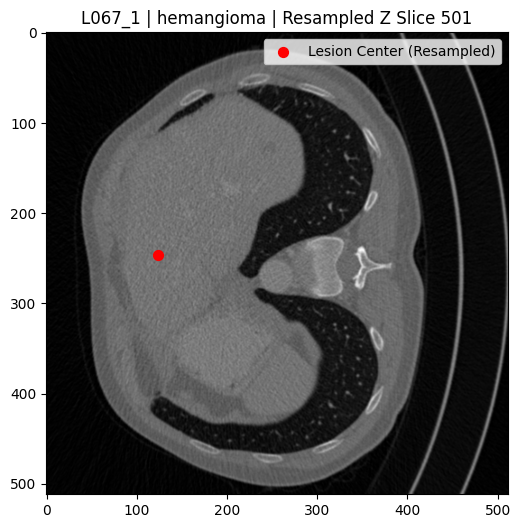

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 560)
center [125 247 501]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L067_1_hemangioma_patch_resampled.nii


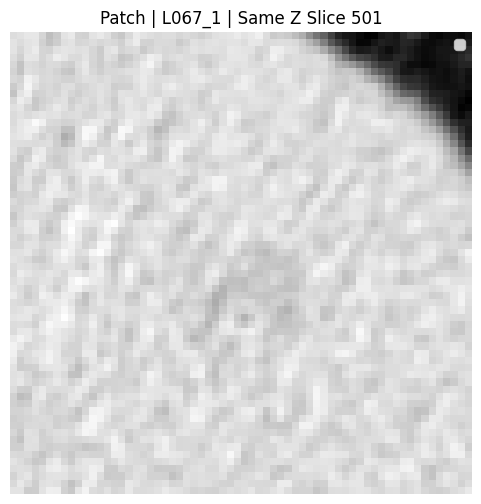

zoom [0.99994353 0.99994353 1.00000001]
original spacing [0.6640625  0.6640625  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [114 209 358] new center [113 208 358]
shape vol (512, 512, 560)
shape new vol (512, 512, 560)
z 358 new z 358


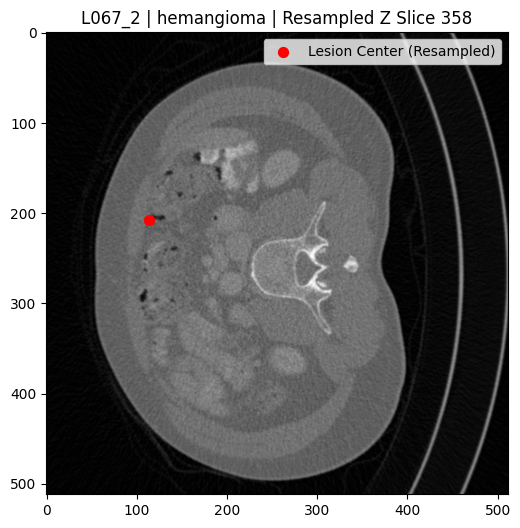

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 560)
center [114 209 358]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L067_2_hemangioma_patch_resampled.nii


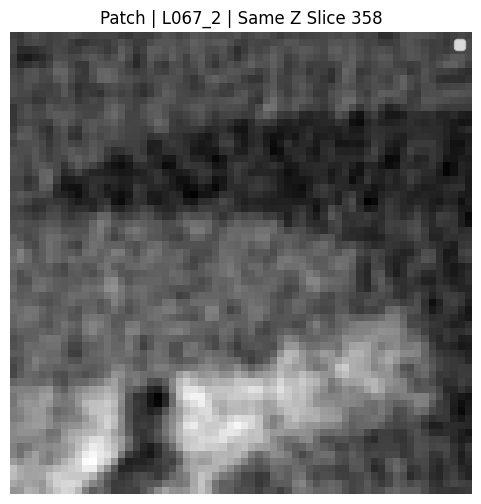

zoom [0.99994353 0.99994353 1.00000001]
original spacing [0.6640625  0.6640625  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [242 161 527] new center [241 160 527]
shape vol (512, 512, 560)
shape new vol (512, 512, 560)
z 527 new z 527


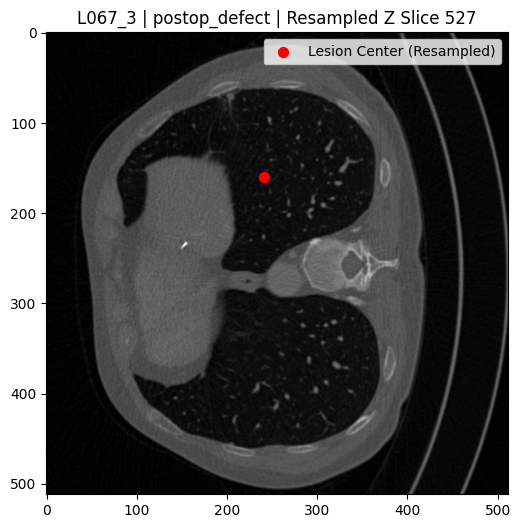

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 560)
center [242 161 527]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L067_3_postop_defect_patch_resampled.nii


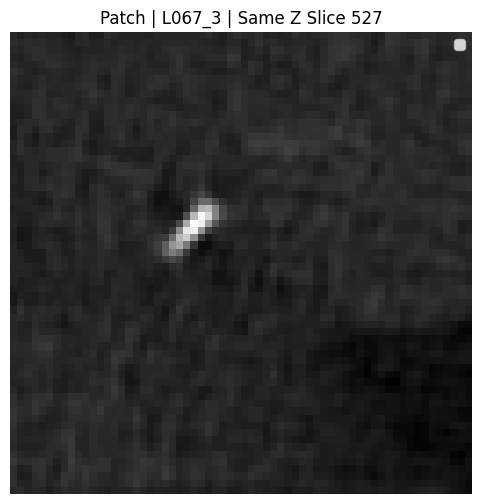

zoom [0.99994353 0.99994353 1.00000001]
original spacing [0.6640625  0.6640625  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [ 83 276 444] new center [ 82 275 444]
shape vol (512, 512, 560)
shape new vol (512, 512, 560)
z 444 new z 444


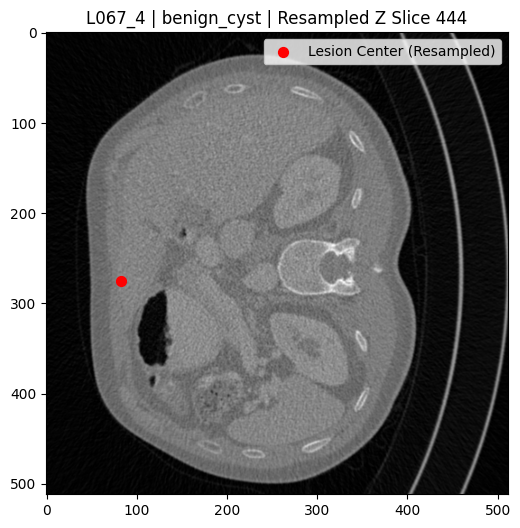

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 560)
center [ 83 276 444]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L067_4_benign_cyst_patch_resampled.nii


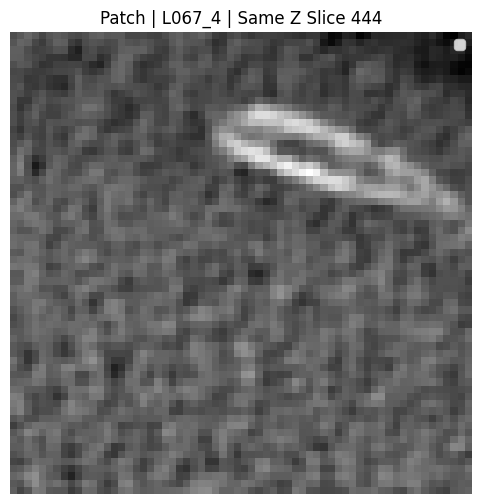

zoom [0.99994353 0.99994353 1.00000001]
original spacing [0.6640625  0.6640625  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [188 123 444] new center [187 122 444]
shape vol (512, 512, 560)
shape new vol (512, 512, 560)
z 444 new z 444


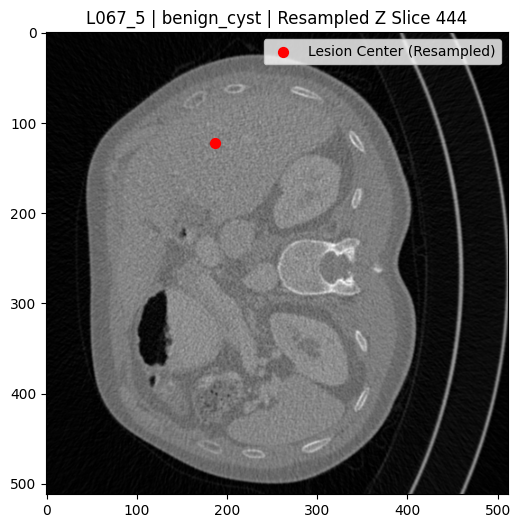

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 560)
center [188 123 444]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L067_5_benign_cyst_patch_resampled.nii


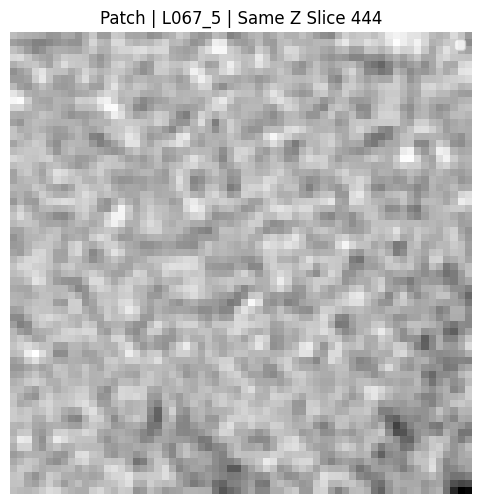

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [122 192 495] new center [136 214 495]
shape vol (512, 512, 823)
shape new vol (572, 572, 823)
z 495 new z 495


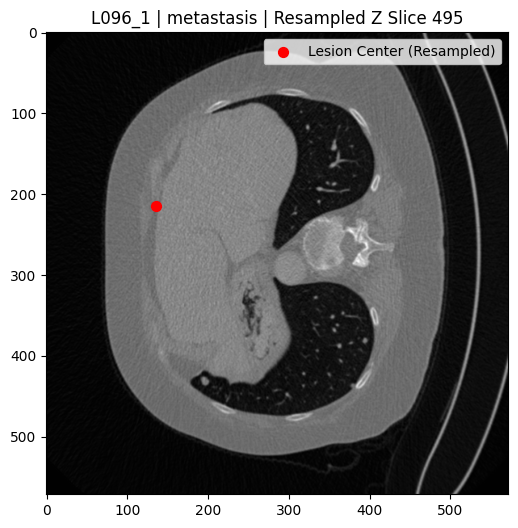

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 823)
center [122 192 495]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L096_1_metastasis_patch_resampled.nii


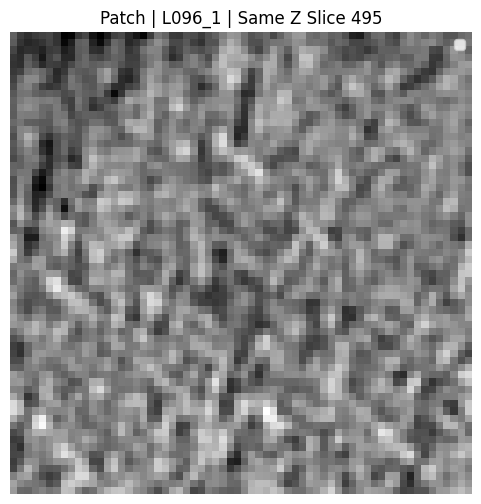

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [197 219 495] new center [220 244 495]
shape vol (512, 512, 823)
shape new vol (572, 572, 823)
z 495 new z 495


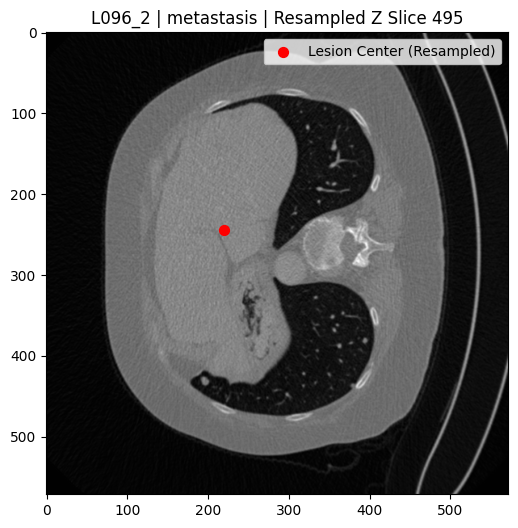

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 823)
center [197 219 495]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L096_2_metastasis_patch_resampled.nii


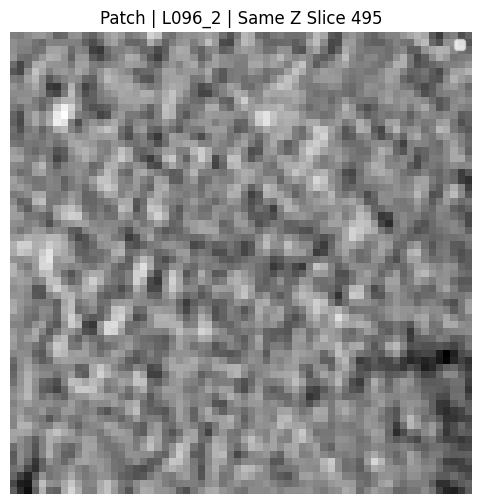

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [ 85 219 475] new center [ 94 244 475]
shape vol (512, 512, 823)
shape new vol (572, 572, 823)
z 475 new z 475


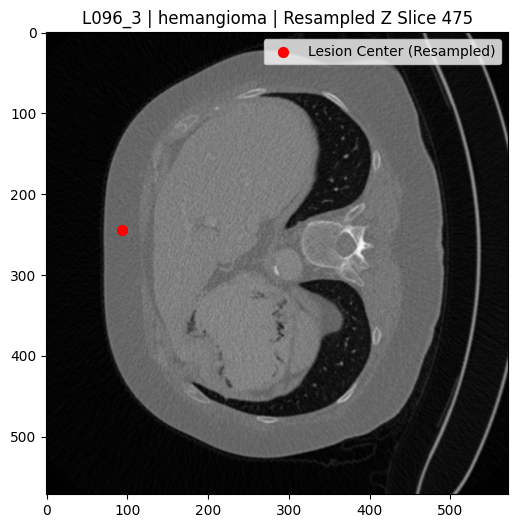

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 823)
center [ 85 219 475]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L096_3_hemangioma_patch_resampled.nii


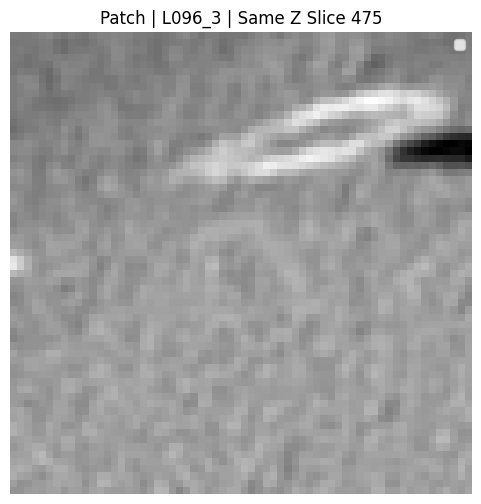

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [138 243 468] new center [154 271 468]
shape vol (512, 512, 823)
shape new vol (572, 572, 823)
z 468 new z 468


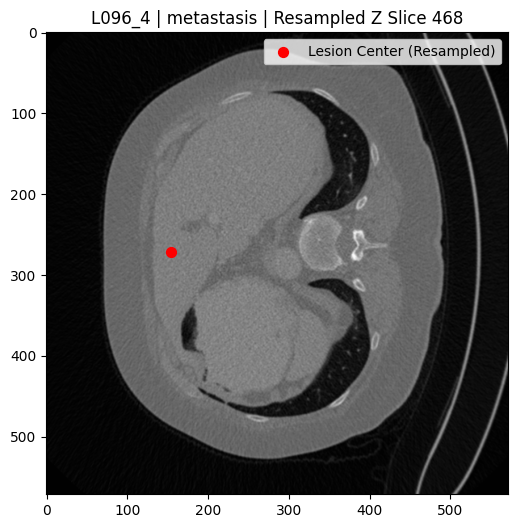

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 823)
center [138 243 468]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L096_4_metastasis_patch_resampled.nii


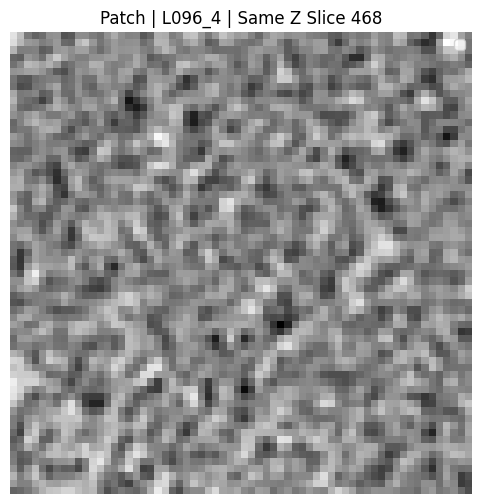

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [207 132 437] new center [231 147 437]
shape vol (512, 512, 823)
shape new vol (572, 572, 823)
z 437 new z 437


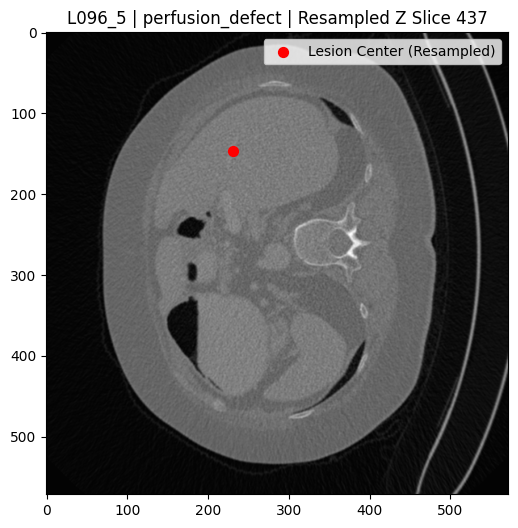

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 823)
center [207 132 437]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L096_5_perfusion_defect_patch_resampled.nii


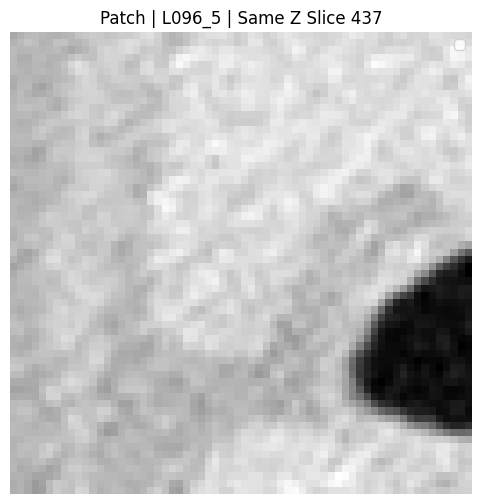

zoom [1.23522436 1.23522436 1.00000001]
original spacing [0.8203125  0.8203125  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [169 164 299] new center [208 202 299]
shape vol (512, 512, 585)
shape new vol (632, 632, 585)
z 299 new z 299


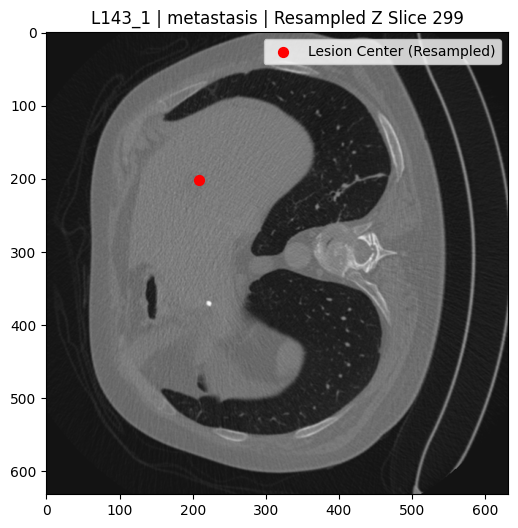

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 585)
center [169 164 299]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L143_1_metastasis_patch_resampled.nii


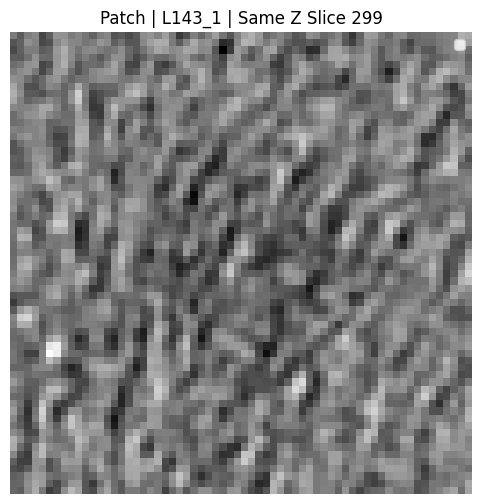

zoom [1.23522436 1.23522436 1.00000001]
original spacing [0.8203125  0.8203125  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [261 168 299] new center [322 207 299]
shape vol (512, 512, 585)
shape new vol (632, 632, 585)
z 299 new z 299


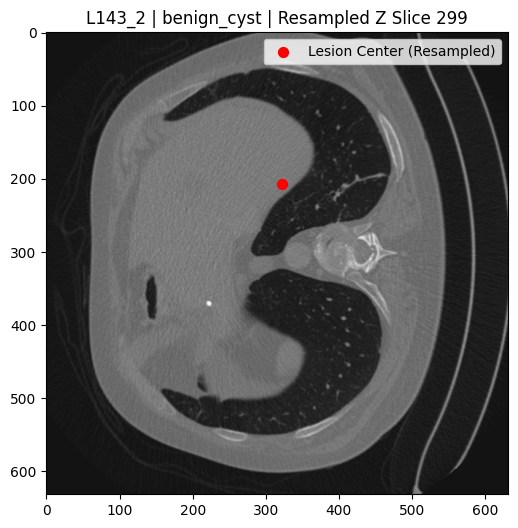

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 585)
center [261 168 299]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L143_2_benign_cyst_patch_resampled.nii


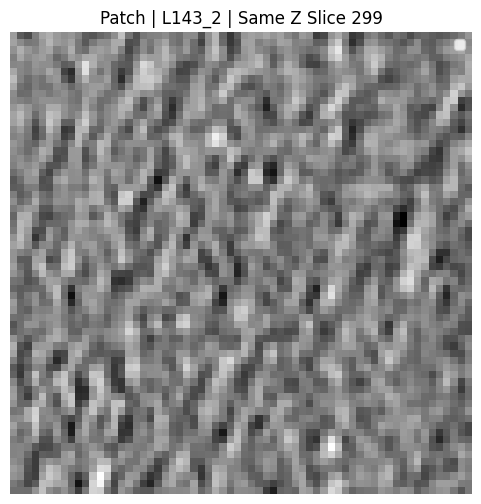

zoom [1.23522436 1.23522436 1.00000001]
original spacing [0.8203125  0.8203125  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [182 239 264] new center [224 295 264]
shape vol (512, 512, 585)
shape new vol (632, 632, 585)
z 264 new z 264


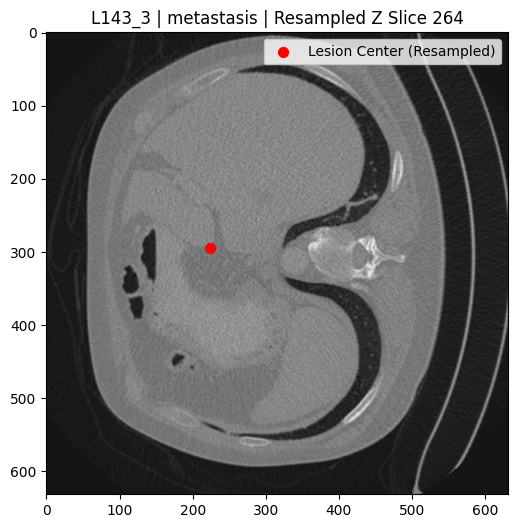

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 585)
center [182 239 264]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L143_3_metastasis_patch_resampled.nii


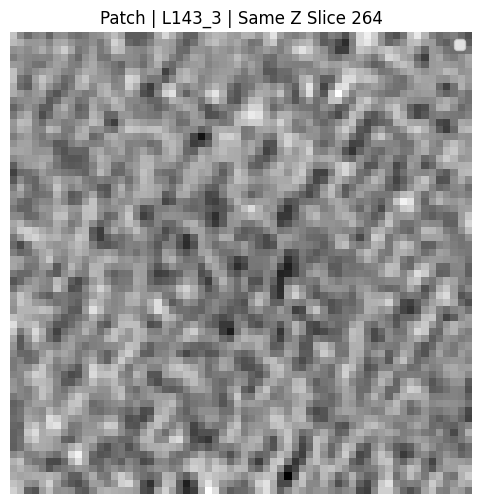

zoom [1.23522436 1.23522436 1.00000001]
original spacing [0.8203125  0.8203125  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [102 200 175] new center [125 247 175]
shape vol (512, 512, 585)
shape new vol (632, 632, 585)
z 175 new z 175


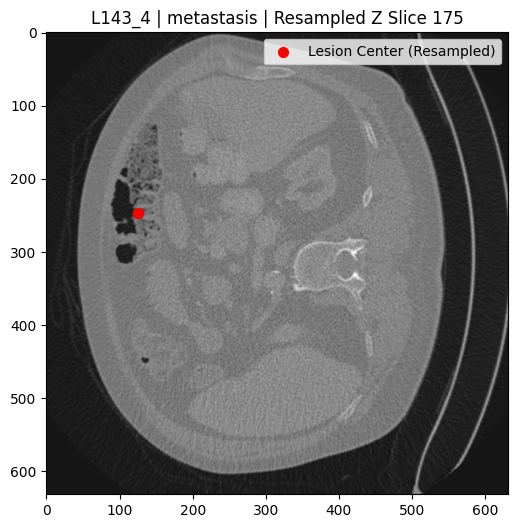

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 585)
center [102 200 175]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L143_4_metastasis_patch_resampled.nii


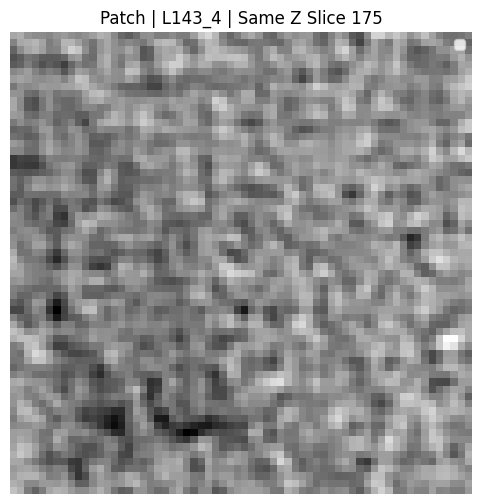

zoom [1.05876374 1.05876374 1.00000001]
original spacing [0.703125   0.703125   0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [221 208 518] new center [233 220 518]
shape vol (512, 512, 600)
shape new vol (542, 542, 600)
z 518 new z 518


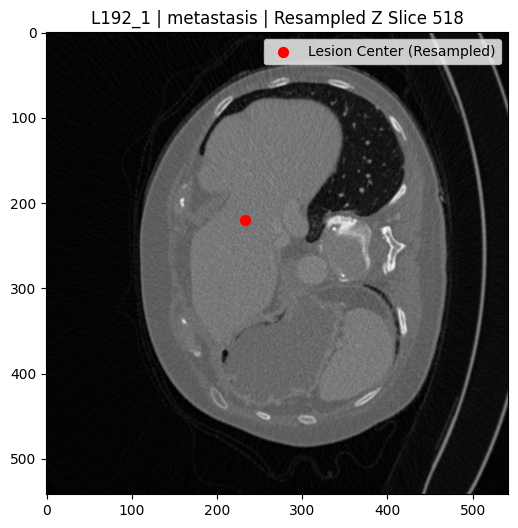

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 600)
center [221 208 518]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L192_1_metastasis_patch_resampled.nii


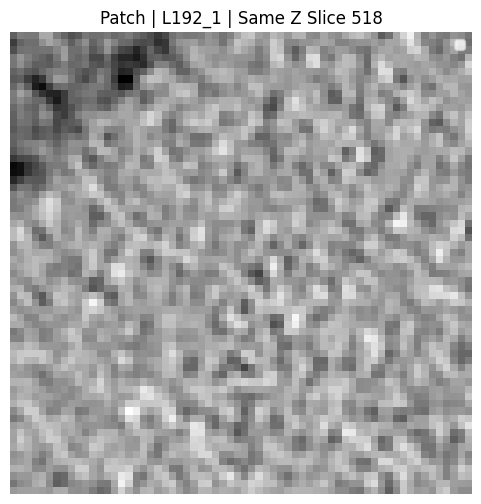

zoom [1.05876374 1.05876374 1.00000001]
original spacing [0.703125   0.703125   0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [200 229 484] new center [211 242 484]
shape vol (512, 512, 600)
shape new vol (542, 542, 600)
z 484 new z 484


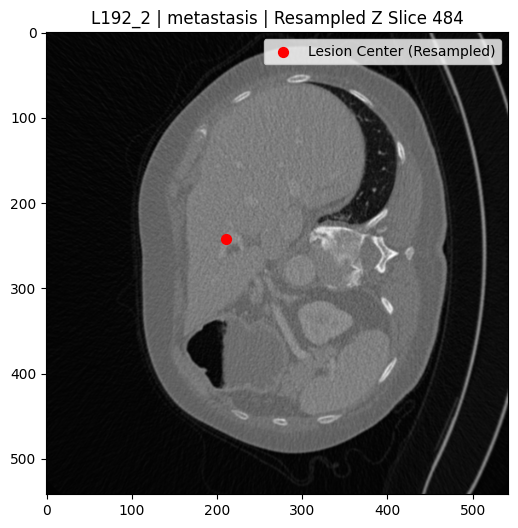

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 600)
center [200 229 484]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L192_2_metastasis_patch_resampled.nii


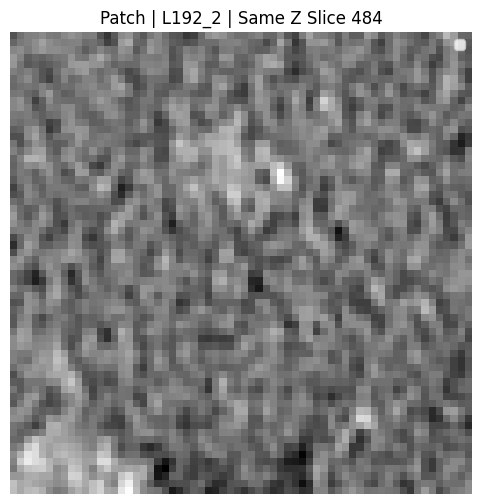

zoom [1.05876374 1.05876374 1.00000001]
original spacing [0.703125   0.703125   0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [103 336 464] new center [109 355 464]
shape vol (512, 512, 600)
shape new vol (542, 542, 600)
z 464 new z 464


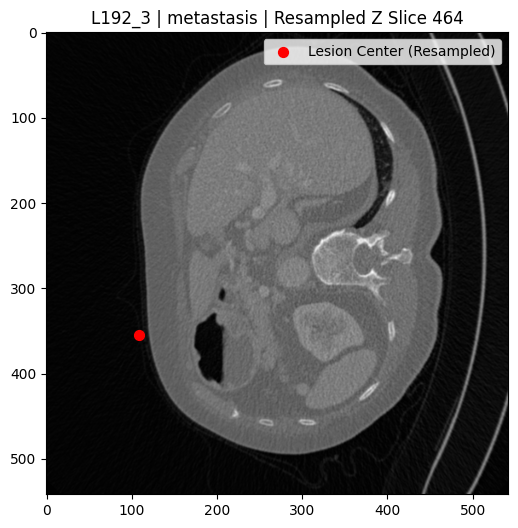

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 600)
center [103 336 464]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L192_3_metastasis_patch_resampled.nii


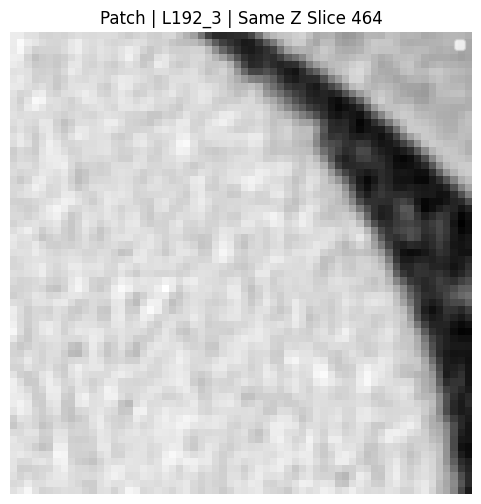

zoom [1.05876374 1.05876374 1.00000001]
original spacing [0.703125   0.703125   0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [120 246 407] new center [127 260 407]
shape vol (512, 512, 600)
shape new vol (542, 542, 600)
z 407 new z 407


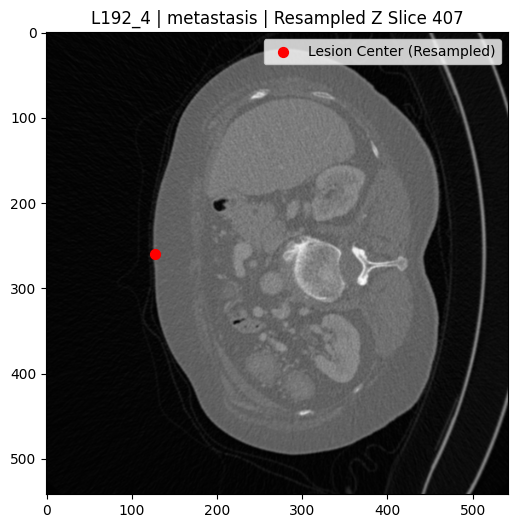

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 600)
center [120 246 407]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L192_4_metastasis_patch_resampled.nii


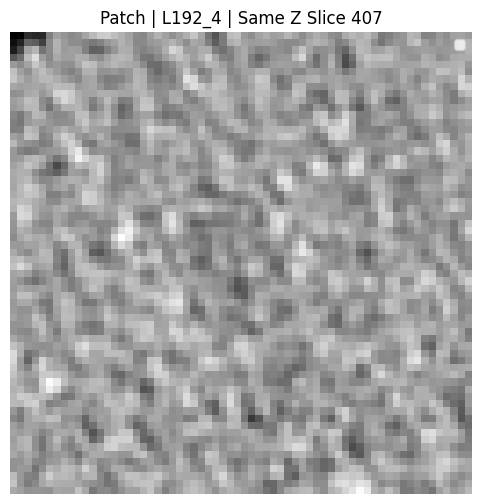

zoom [1.05876374 1.05876374 1.00000001]
original spacing [0.703125   0.703125   0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [139 321 407] new center [147 339 407]
shape vol (512, 512, 600)
shape new vol (542, 542, 600)
z 407 new z 407


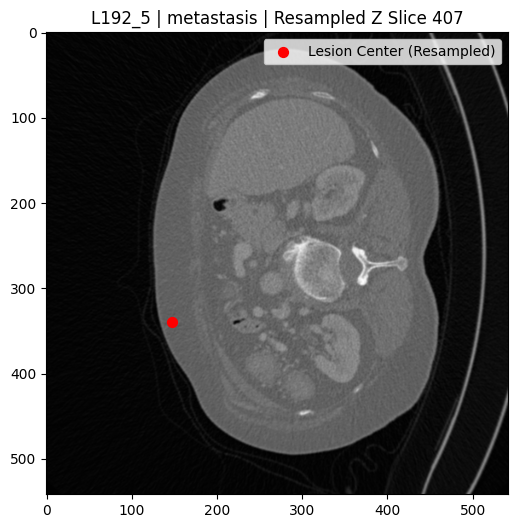

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 600)
center [139 321 407]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L192_5_metastasis_patch_resampled.nii


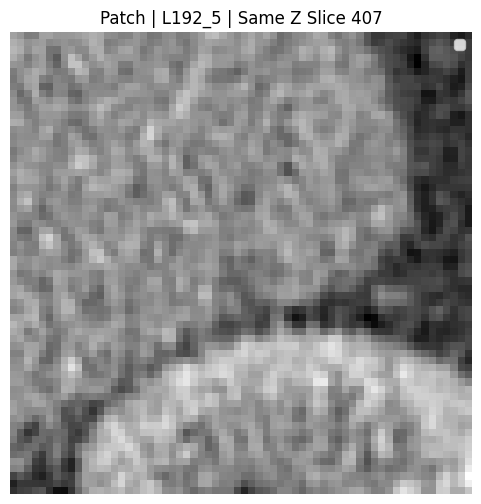

zoom [0.99994353 0.99994353 1.00000001]
original spacing [0.6640625  0.6640625  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [177 140 493] new center [176 139 493]
shape vol (512, 512, 525)
shape new vol (512, 512, 525)
z 493 new z 493


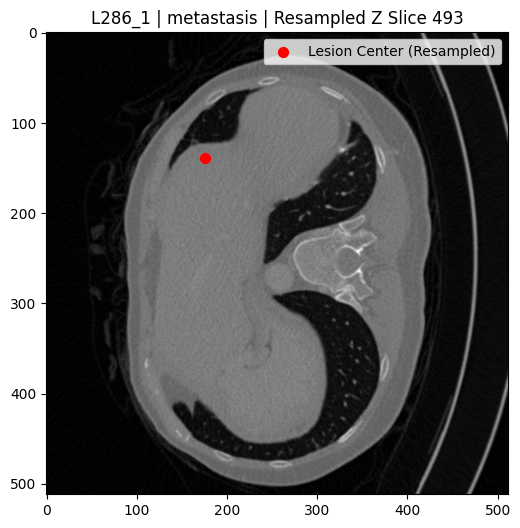

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 525)
center [177 140 493]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L286_1_metastasis_patch_resampled.nii


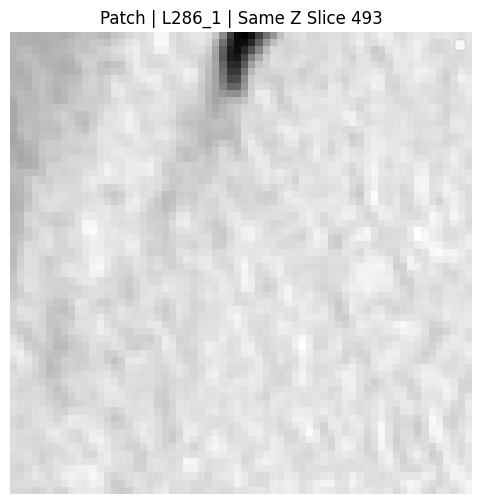

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [152 271 560] new center [169 302 560]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)
z 560 new z 560


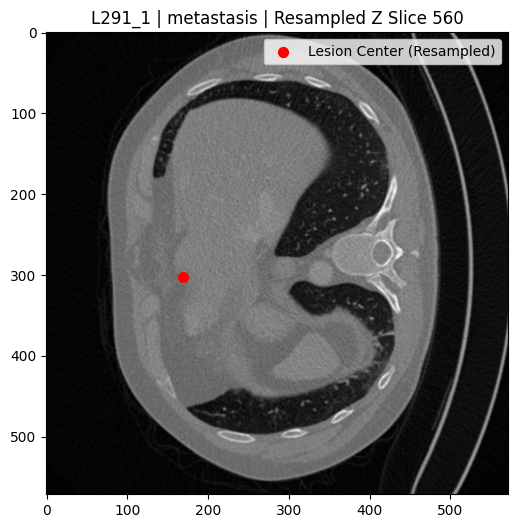

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [152 271 560]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L291_1_metastasis_patch_resampled.nii


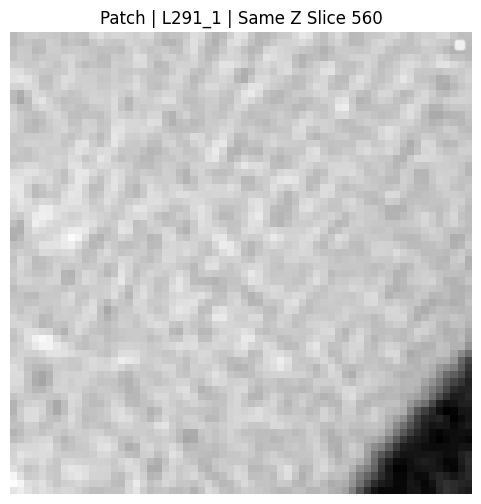

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [164 154 560] new center [183 172 560]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)
z 560 new z 560


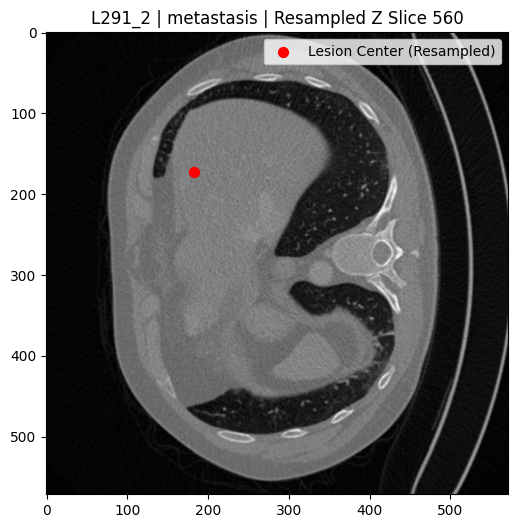

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [164 154 560]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L291_2_metastasis_patch_resampled.nii


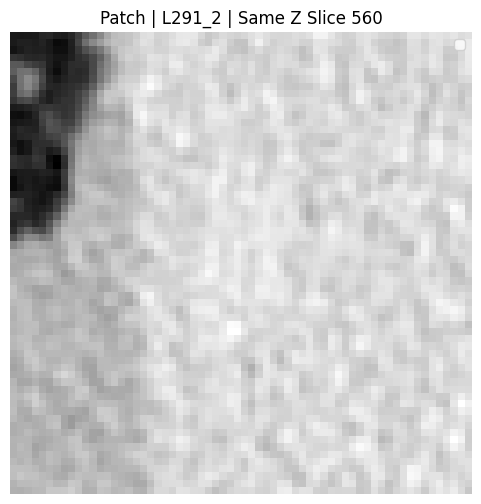

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [153 273 547] new center [170 305 547]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)
z 547 new z 547


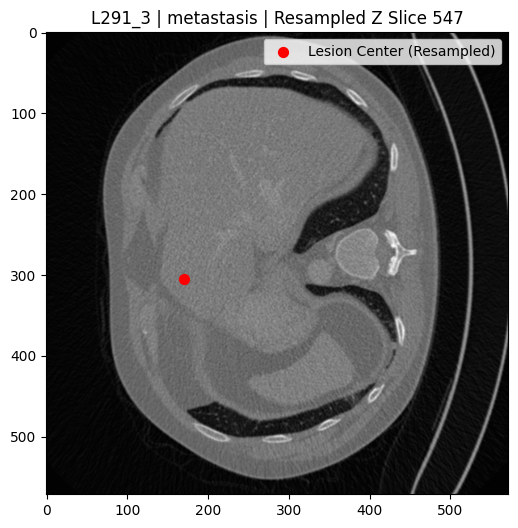

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [153 273 547]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L291_3_metastasis_patch_resampled.nii


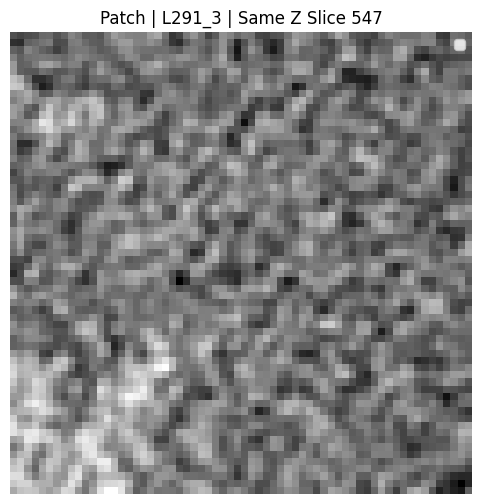

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [150 167 483] new center [167 186 483]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)
z 483 new z 483


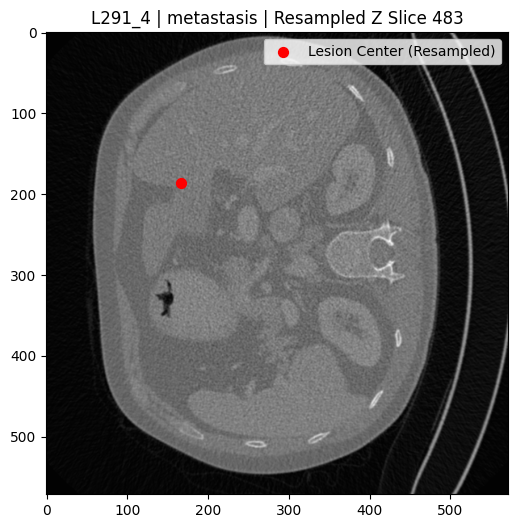

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [150 167 483]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L291_4_metastasis_patch_resampled.nii


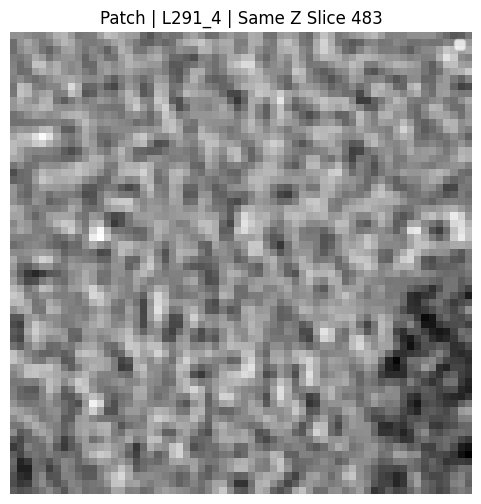

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [117 274 338] new center [130 306 338]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)
z 338 new z 338


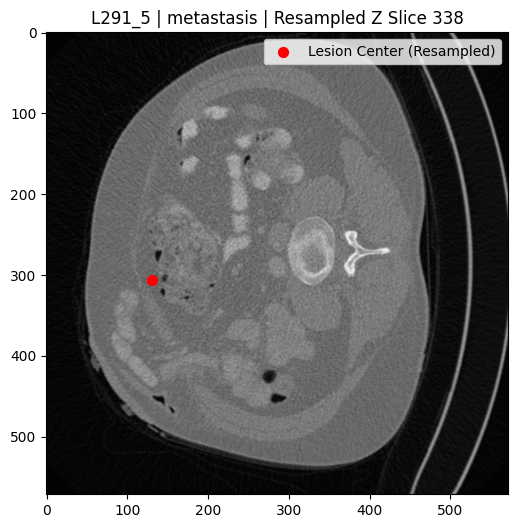

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [117 274 338]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L291_5_metastasis_patch_resampled.nii


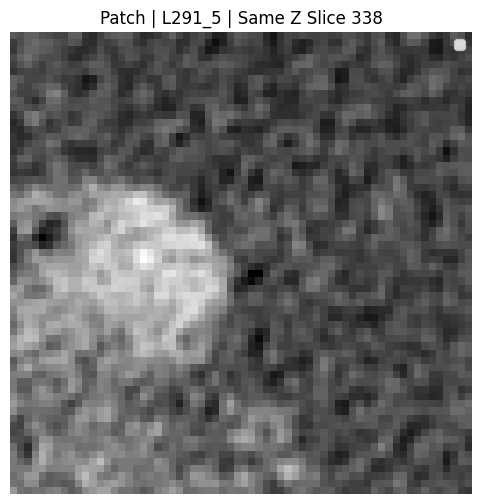

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [169 196 490] new center [188 219 490]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)
z 490 new z 490


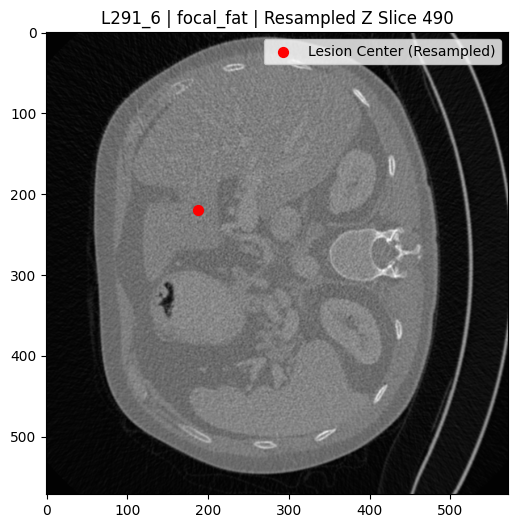

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [169 196 490]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L291_6_focal_fat_patch_resampled.nii


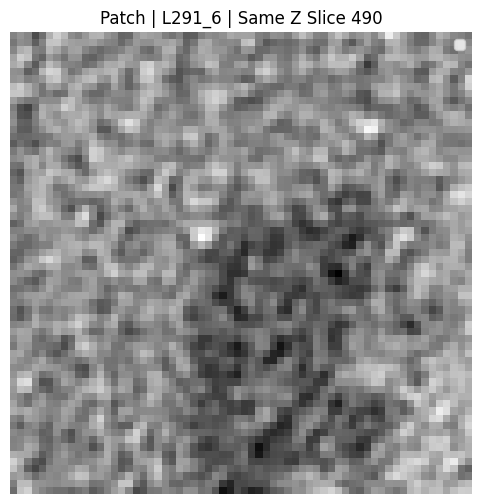

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [133 197 444] new center [148 220 444]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)
z 444 new z 444


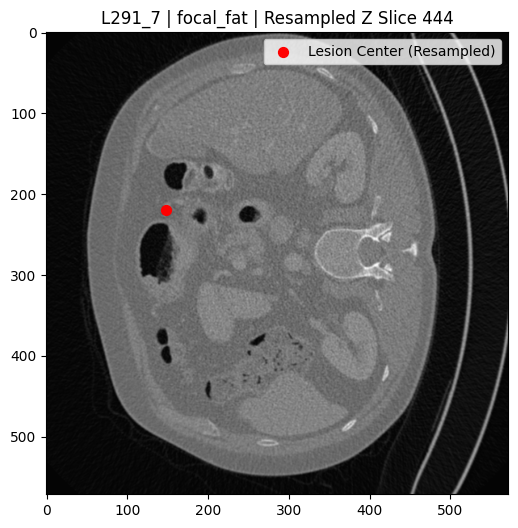

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [133 197 444]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L291_7_focal_fat_patch_resampled.nii


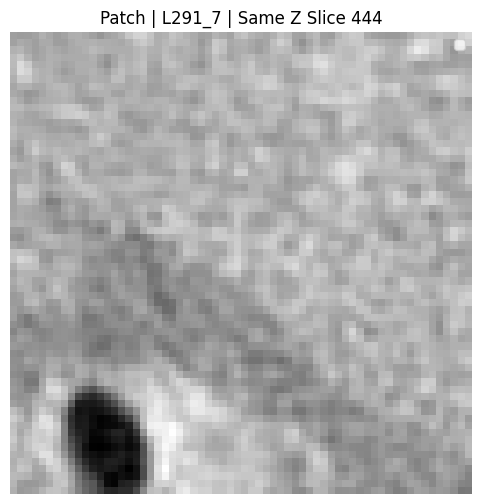

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [194 174 483] new center [216 194 483]
shape vol (512, 512, 856)
shape new vol (572, 572, 856)
z 483 new z 483


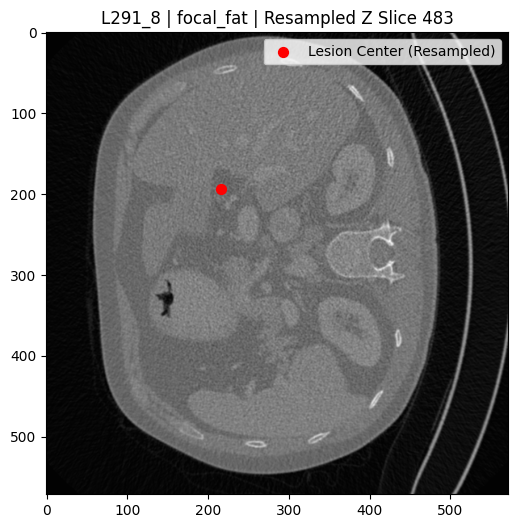

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 856)
center [194 174 483]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L291_8_focal_fat_patch_resampled.nii


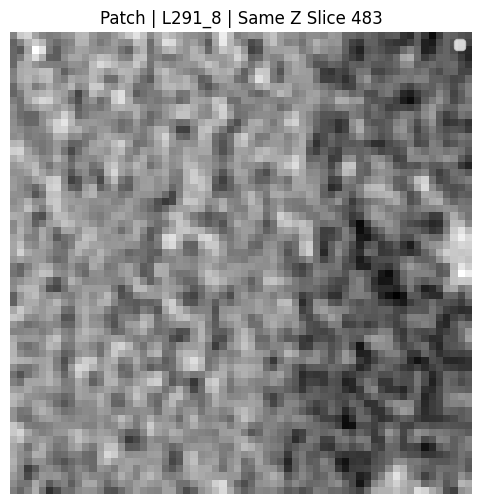

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [150 311 467] new center [167 347 467]
shape vol (512, 512, 533)
shape new vol (572, 572, 533)
z 467 new z 467


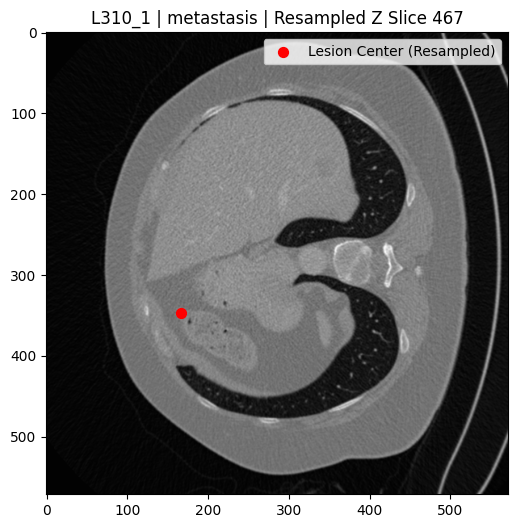

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 533)
center [150 311 467]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L310_1_metastasis_patch_resampled.nii


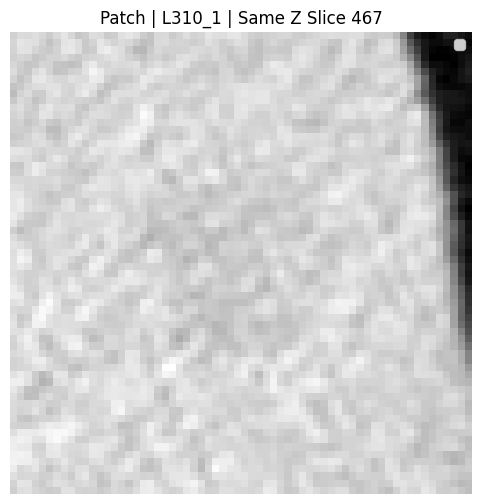

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [144 264 440] new center [160 295 440]
shape vol (512, 512, 526)
shape new vol (572, 572, 526)
z 440 new z 440


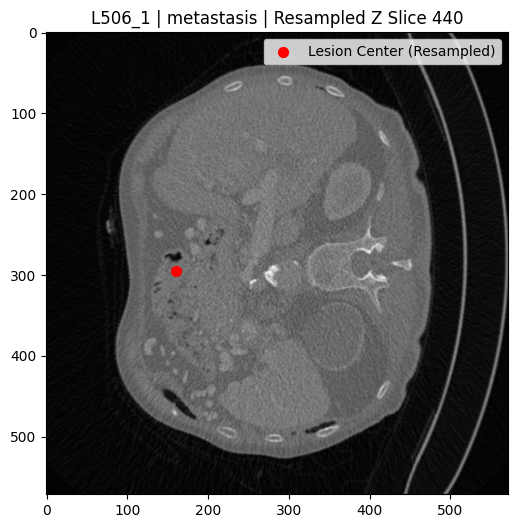

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 526)
center [144 264 440]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L506_1_metastasis_patch_resampled.nii


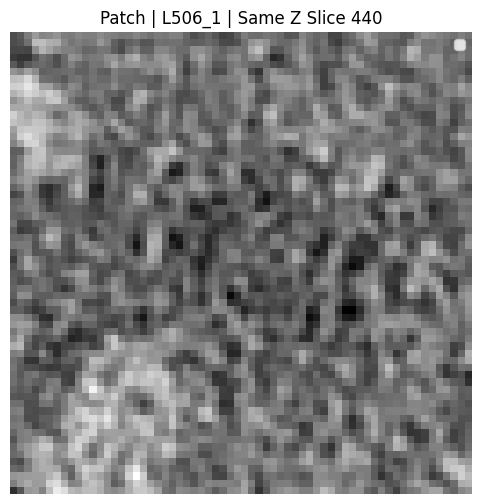

zoom [1.11758395 1.11758395 1.00000001]
original spacing [0.7421875  0.7421875  0.80000001]
desired spacing [0.6641, 0.6641, 0.8]
center [166 218 418] new center [185 243 418]
shape vol (512, 512, 526)
shape new vol (572, 572, 526)
z 418 new z 418


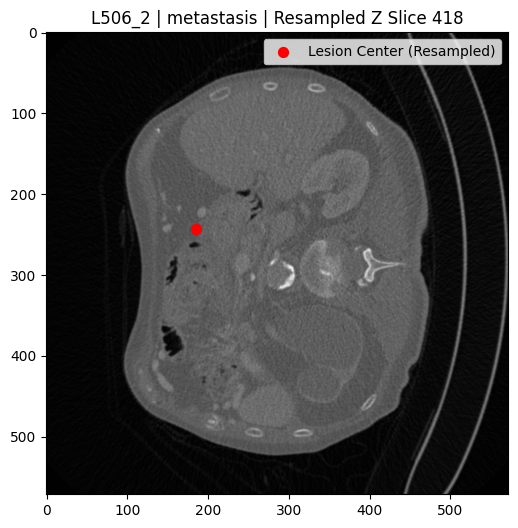

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


shape (512, 512, 526)
center [166 218 418]
(64, 64, 32)
Saved patch: /mnt/nas7/data/maria/final_features/patches_lowdose/QD_L506_2_metastasis_patch_resampled.nii


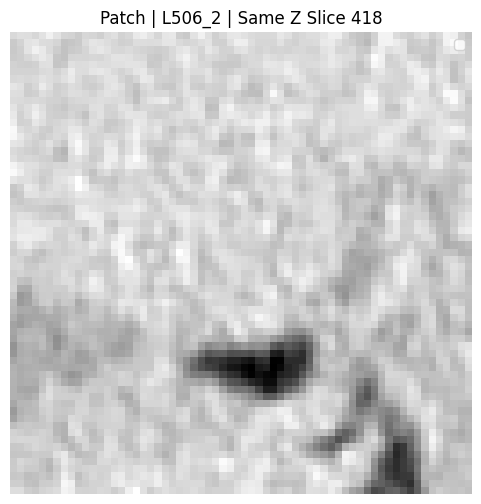

In [5]:
roi_data = [
    ("L067", 15.2643, [125, 247, 501], "hemangioma", "L067_1"), # X Y Z
    ("L067", 13.0384, [114, 209, 358], "hemangioma", "L067_2"),
    ("L067", 17.0294, [242, 161, 527], "postop_defect", "L067_3"),
    ("L067", 4.0, [83, 276, 444], "benign_cyst", "L067_4"),
    ("L067", 5.65685, [188, 123, 444], "benign_cyst", "L067_5"),
    ("L096", 23.4094, [122, 192, 495], "metastasis", "L096_1"),
    ("L096", 14.0, [197, 219, 495], "metastasis", "L096_2"),
    ("L096", 8.94427, [85, 219, 475], "hemangioma", "L096_3"),
    ("L096", 7.0, [138, 243, 468], "metastasis", "L096_4"),
    ("L096", 11.4018, [207, 132, 437], "perfusion_defect", "L096_5"),
    ("L143", 16.1555, [169, 164, 299], "metastasis", "L143_1"),
    ("L143", 4.12311, [261, 168, 299], "benign_cyst", "L143_2"),
    ("L143", 15.2643, [182, 239, 264], "metastasis", "L143_3"),
    ("L143", 9.21954, [102, 200, 175], "metastasis", "L143_4"),
    ("L192", 5.65685, [221, 208, 518], "metastasis", "L192_1"),
    ("L192", 6.0, [200, 229, 484], "metastasis", "L192_2"),
    ("L192", 5.09902, [103, 336, 464], "metastasis", "L192_3"),
    ("L192", 10.4403, [120, 246, 407], "metastasis", "L192_4"),
    ("L192", 5.09902, [139, 321, 407], "metastasis", "L192_5"),
    ("L286", 7.28011, [177, 140, 493], "metastasis", "L286_1"),
    ("L291", 13.0384, [152, 271, 560], "metastasis", "L291_1"),
    ("L291", 16.2788, [164, 154, 560], "metastasis", "L291_2"),
    ("L291", 16.1245, [153, 273, 547], "metastasis", "L291_3"),
    ("L291", 20.6155, [150, 167, 483], "metastasis", "L291_4"),
    ("L291", 16.4012, [117, 274, 338], "metastasis", "L291_5"),
    ("L291", 13.0384, [169, 196, 490], "focal_fat", "L291_6"),
    ("L291", 14.2127, [133, 197, 444], "focal_fat", "L291_7"),
    ("L291", 11.4018, [194, 174, 483], "focal_fat", "L291_8"),
    ("L310", 13.1529, [150, 311, 467], "metastasis", "L310_1"),
    ("L506", 21.6333, [144, 264, 440], "metastasis", "L506_1"),
    ("L506", 12.083, [166, 218, 418], "metastasis", "L506_2"),
]


input_dir = "/mnt/nas7/data/maria/final_features/nifti_new_dataset"
patch_size = np.array([64, 64, 32])  # (X, Y, Z)
#patch_size = np.array([32, 64, 64])  # (Z, Y, X)

#desired_spacing = [0.8, 0.8, 0.8]  # mm
desired_spacing = [0.6641, 0.6641, 0.8] # mínimo común

for case_name, radius_mm, center, lesion, screenshot in roi_data:
    nifti_path = os.path.join(input_dir, f"QD_{case_name}.nii")
    if not os.path.exists(nifti_path):
        print(f"File not found: {nifti_path}")
        continue

    nifti_img = nib.load(nifti_path)
    volume = nifti_img.get_fdata()      # Z Y X

    affine = nifti_img.affine
    # Get original voxel spacing from the affine matrix
    original_spacing = np.abs(np.diag(affine)[:3])      # X Y Z 
    zoom_factors = original_spacing / desired_spacing

    print('zoom', zoom_factors)

    volume = np.swapaxes(volume, 0, 2)

    # Resample volume to desired voxel spacing
    resampled_volume = zoom(volume, zoom=zoom_factors, order=3)

    # Adjust the lesion center to resampled space
    center_phys = np.array(center) * original_spacing
    new_center = (center_phys / desired_spacing).astype(int)


    center = np.array(center).astype(int)

    print('original spacing', original_spacing)
    print('desired spacing', desired_spacing)

    print('center', center, 'new center', new_center)

    print('shape vol', volume.shape)
    print('shape new vol', resampled_volume.shape)
    

    z = center[2]
    z_resampled = new_center[2]
    print('z', z, 'new z', z_resampled)

    
    plt.figure(figsize=(6, 6))
    plt.imshow(resampled_volume[:, :, z_resampled], cmap='gray')
    plt.scatter(new_center[0], new_center[1], c='red', s=50, label='Lesion Center (Resampled)')
    plt.title(f"{screenshot} | {lesion} | Resampled Z Slice {z_resampled}")
    plt.legend()
    plt.show()

    # Extract patch
    half_patch = patch_size // 2
    min_corner = np.maximum(new_center - half_patch, 0)
    max_corner = np.minimum(new_center + half_patch, resampled_volume.shape)
    print('shape', volume.shape)
    print('center', center)

    patch = resampled_volume[
        min_corner[0]:max_corner[0],
        min_corner[1]:max_corner[1],
        min_corner[2]:max_corner[2]
    ]
    
    print(patch.shape)

    output_dir = '/mnt/nas7/data/maria/final_features/patches_lowdose'
    patch_nifti = nib.Nifti1Image(patch, affine)
    patch_output_path = os.path.join(output_dir, f"QD_{screenshot}_{lesion}_patch_resampled.nii")
    nib.save(patch_nifti, patch_output_path)

    print(f"Saved patch: {patch_output_path}")


    # Determine which slice in the patch corresponds to center[2]
    z_start = min_corner[2]
    z_idx_in_patch = new_center[2] - z_start

    # Plot the same Z slice from the patch
    if 0 <= z_idx_in_patch < patch.shape[2]:
        plt.figure(figsize=(6, 6))
        plt.imshow(patch[:, :, z_idx_in_patch], cmap='gray')
        plt.title(f"Patch | {screenshot} | Same Z Slice {new_center[2]}")
        plt.legend()
        plt.axis('off')
        plt.show()
    else:
        print(f"Z index {z_idx_in_patch} out of patch bounds for {screenshot}")



In [5]:
from medmnist import OrganMNIST3D
from medmnist import INFO


In [19]:
dataset = OrganMNIST3D(split="test", download=True)

Using downloaded and verified file: /home/maria/.medmnist/organmnist3d.npz


In [20]:
print(INFO['organmnist3d']['label'])  # gives you the dictionary of label names


{'0': 'liver', '1': 'kidney-right', '2': 'kidney-left', '3': 'femur-right', '4': 'femur-left', '5': 'bladder', '6': 'heart', '7': 'lung-right', '8': 'lung-left', '9': 'spleen', '10': 'pancreas'}


In [21]:
print(len(dataset))
img, label = dataset[100]
print(img.shape)   # should be (1, 28, 28, 28)
print(label)


610
(1, 28, 28, 28)
[10]


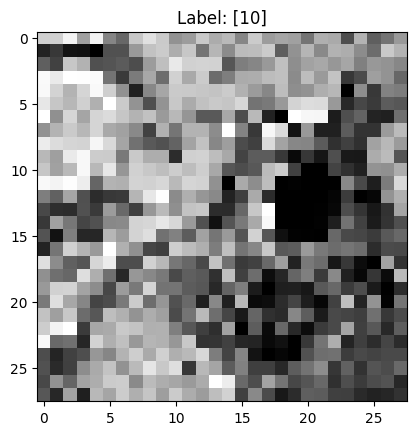

In [22]:
import matplotlib.pyplot as plt

# Visualize the middle slice
plt.imshow(img[0, :, :, 14], cmap='gray')
plt.title(f"Label: {label}")
plt.show()


In [8]:
from datasets import load_dataset  

dataset = load_dataset("randall-lab/medmnist", name="organmnist3d", split="train", trust_remote_code=True)  


In [20]:
import nibabel as nib
from scipy.ndimage import center_of_mass
import numpy as np


def compute_organ_centers(mask_path):
    label_to_name = {
        1: "liver",
        2: "bladder",
        3: "lungs",
        4: "kidneys",
        5: "bone",
        6: "brain"
    }

    mask_nii = nib.load(mask_path)
    mask = mask_nii.get_fdata()
    mask = np.round(mask).astype(np.uint8)
    print('Unique labels:', np.unique(mask))

    centers = {}
    for label, name in label_to_name.items():
        organ_mask = (mask == label)
        if np.any(organ_mask):
            center = center_of_mass(organ_mask)
            centers[name] = tuple(int(round(c)) for c in center)
    return centers

In [21]:
centers = compute_organ_centers("/mnt/nas7/data/maria/final_features/CT-ORG/masks/labels-3.nii.gz")
print(centers)

Unique labels: [0 1 2 3 4 5]
{'liver': (135, 326, 410), 'bladder': (255, 284, 150), 'lungs': (254, 261, 486), 'kidneys': (243, 233, 352), 'bone': (260, 216, 238)}


2025-04-23 14:21:08.422514: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-23 14:21:08.462149: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-04-23 14:21:08.462178: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-04-23 14:21:08.463124: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-04-23 14:21:08.470225: I tensorflow/core/platform/cpu_feature_guar

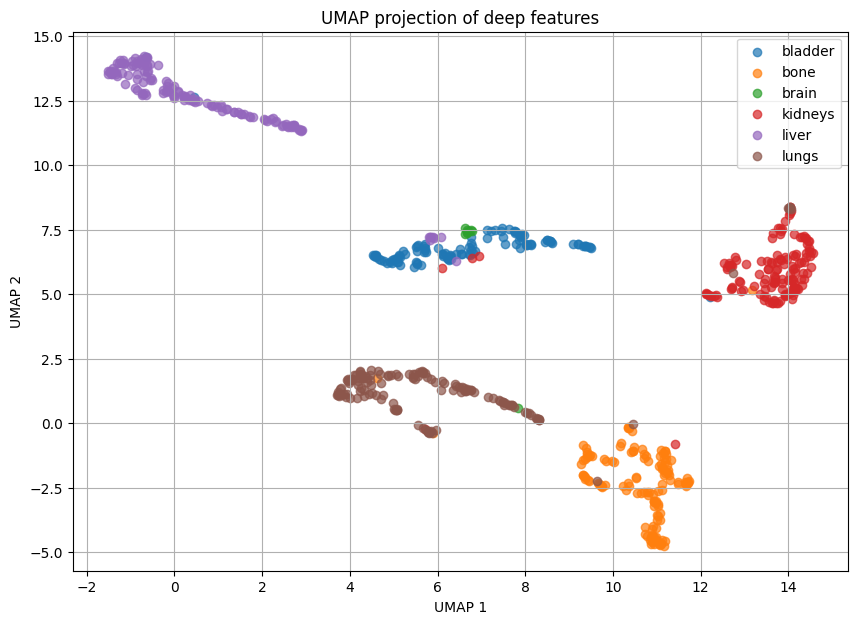

In [1]:
import pandas as pd
import numpy as np
import umap
import matplotlib.pyplot as plt
import ast

# Carga tu CSV
df = pd.read_csv('/mnt/nas7/data/maria/final_features/ct-fm/ct-org/features_ct-fm_org.csv')  # cambia por el path correcto

# Convierte las deep features de string a listas de float
df['deepfeatures'] = df['deepfeatures'].apply(ast.literal_eval)

# Crea un array de features
X = np.array(df['deepfeatures'].tolist())

# Opcional: codificar las clases/ROIs si tienes múltiples
labels = df['ROI']  # puede ser 'liver', etc.

# Aplica UMAP
reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, metric='euclidean', random_state=42)
embedding = reducer.fit_transform(X)

# Visualiza
plt.figure(figsize=(10, 7))
for roi in np.unique(labels):
    mask = labels == roi
    plt.scatter(embedding[mask, 0], embedding[mask, 1], label=roi, alpha=0.7)

plt.title("UMAP projection of deep features")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.legend()
plt.grid(True)
plt.show()


In [4]:
import os
import numpy as np
import csv
from tqdm import tqdm
import nibabel as nib
from monai.transforms import Compose, LoadImage, EnsureType
import json

In [5]:
def load_data(datalist_json_path):
    """
    Loads data from a JSON file.
    Args:
        datalist_json_path (str): Path to the JSON file containing the data list.
    Returns:
        dict: A dictionary of the data list loaded from the JSON file.
    """
    with open(datalist_json_path, 'r') as f:
            datalist = json.load(f)
    return datalist

In [6]:
transforms = Compose([
LoadImage(ensure_channel_first=True),  # Load image and ensure channel dimension
EnsureType(),                         # Ensure correct data type
])


In [ ]:
jsonpath = "/mnt/nas7/data/maria/final_features/expanded_registered_light_dataset_info.json"
datafiles = load_data(jsonpath)
nifti_dir = "/mnt/nas7/data/reza/registered_dataset_all_doses_pad_updated_NotRegistered/"
#datafiles = [f for f in os.listdir(nifti_dir) if f.endswith(".nii.gz")][:3]
datafiles = sorted([f for f in os.listdir(nifti_dir) if f.endswith(".nii.gz")])[:2]

output_dir = "/mnt/nas7/data/maria/final_features/"
output_file = os.path.join(output_dir, "cnn_features_not_registered.csv")


        
for file in tqdm(datafiles, desc="Processing CT scans"):
    file_path = os.path.join(nifti_dir, file)
    image = transforms(file_path)

    file_name = file.replace(".nii.gz", "")
    print(file_name)

Processing CT scans:   0%|          | 0/2 [00:00<?, ?it/s]


File: A1_174008_691000_SOMATOM_Definition_Edge_ID1001_Harmonized_1mGy_IR_NrFiles_343.nii.gz
Shape: (512, 512, 343)


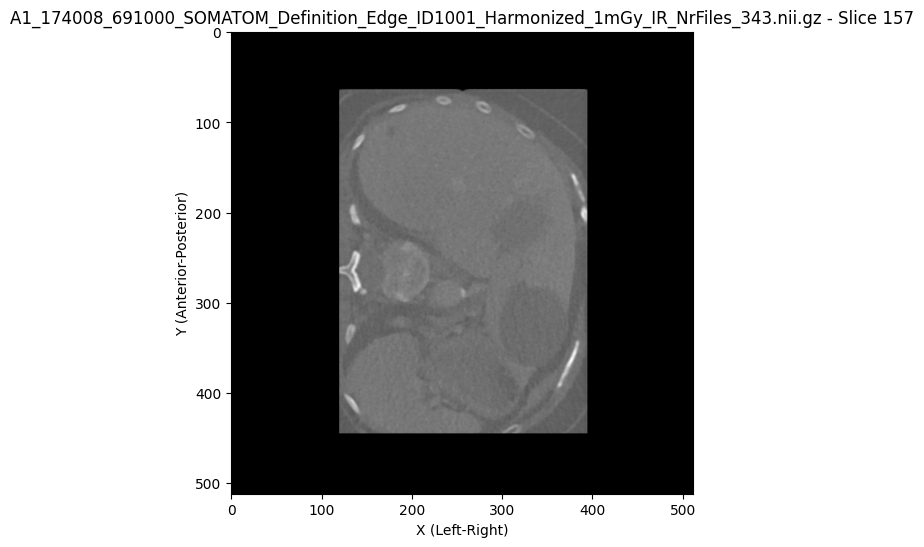

Processing CT scans:  50%|█████     | 1/2 [00:02<00:02,  2.53s/it]


File: A1_174008_691000_SOMATOM_Definition_Edge_ID1002_Harmonized_1mGy_FBP_NrFiles_343.nii.gz
Shape: (512, 512, 343)


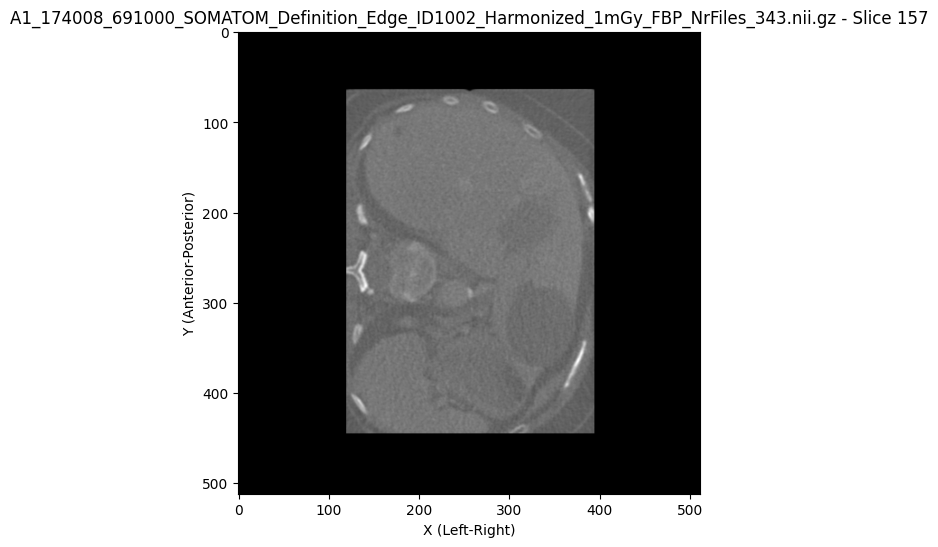

Processing CT scans: 100%|██████████| 2/2 [00:05<00:00,  2.56s/it]


In [10]:
import os
import nibabel as nib
import matplotlib.pyplot as plt
from tqdm import tqdm

nifti_dir = "/mnt/nas7/data/reza/registered_dataset_all_doses_pad_updated_NotRegistered/"
datafiles = sorted([f for f in os.listdir(nifti_dir) if f.endswith(".nii.gz")])[:2]

for file in tqdm(datafiles, desc="Processing CT scans"):
    file_path = os.path.join(nifti_dir, file)
    img = nib.load(file_path)
    data = img.get_fdata()

    print(f"\nFile: {file}")
    print(f"Shape: {data.shape}")

    # Plot the middle slice in the axial plane
    middle_slice = data.shape[2] // 2
    plt.figure(figsize=(6, 6))
    
    # Visualize the slice
    plt.imshow(data[:, :, 157], cmap='gray')
    
    # Adding axis with numbers
    plt.title(f"{file} - Slice {157}")
    plt.axis('on')  # Show axes with numbers
    plt.xlabel("X (Left-Right)")
    plt.ylabel("Y (Anterior-Posterior)")
    
    plt.show()


In [8]:
print(nib.aff2axcodes(img.affine))


('L', 'A', 'S')


In [2]:
import csv

# Paths to your files
features_csv = "/mnt/nas7/data/maria/final_features/swinunetr_features_not_registered.csv"
metadata_csv = "/mnt/nas7/data/maria/final_features/ct-fm/dicom_metadata/dicom_metadata.csv"
output_csv = "/mnt/nas7/data/maria/final_features/swinunetr_features_not_registered_fixed.csv"  # or overwrite the original

# Step 1: Load metadata with correct SeriesNumbers
metadata_dict = {}
with open(metadata_csv, mode='r') as file:
    reader = csv.DictReader(file)
    for row in reader:
        folder_name = row["Folder"]
        metadata_dict[folder_name] = row.get("SeriesNumber", "Unknown")

# Step 2: Load features, fix SeriesNumber
updated_rows = []
with open(features_csv, mode='r') as file:
    reader = csv.DictReader(file)
    fieldnames = reader.fieldnames  # preserve column order
    for row in reader:
        file_name = row["FileName"].replace(".nii.gz", "")
        if file_name in metadata_dict:
            row["SeriesNumber"] = metadata_dict[file_name]
        else:
            row["SeriesNumber"] = "Unknown"
        updated_rows.append(row)

# Step 3: Save to new CSV
with open(output_csv, mode='w', newline='') as file:
    writer = csv.DictWriter(file, fieldnames=fieldnames)
    writer.writeheader()
    writer.writerows(updated_rows)

print("SeriesNumber updated successfully!")


SeriesNumber updated successfully!
